In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
from scipy import linalg
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
print(os.getcwd())

/oasis/projects/nsf/uoo104/ebeyerle/1UBQ-extend/PCA/notebooks


In [2]:
def manhattan_norm(a, b):
    norm = 0
    #for i in range(a.shape[0]):
    norm = abs(a[:] - b[:]).sum()
    return norm
def l2_norm(a, b):
    norm = np.sqrt(((a - b)**2).sum())
    return norm

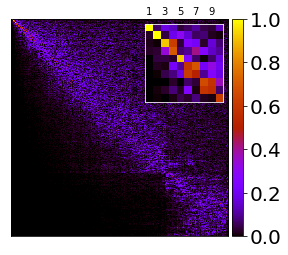

In [3]:
#Overlap matrices with and without HI
#Calculate first to see how best to compare the modes
from mpl_toolkits.axes_grid1 import make_axes_locatable

n = nres = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
QINV = np.linalg.inv(Q)
QHAINV = np.linalg.inv(QHA)

dp_array = np.zeros_like(Q)
for i in range(Q.shape[1]):
    for j in range(QHAINV.shape[0]):
        dp_array[i,j] = np.dot(Q[:, i], QHA[:, j])
tics = [0.0,0.2,0.4,0.6,0.8,1.0]
L_overlap = np.matmul(Q, QHAINV)[:10, :10]

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(dp_array[:-6, :-6]),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
axins = zoomed_inset_axes(ax0, zoom = 8, loc = 'upper right')
axins.matshow(abs(dp_array)[:10,:10], cmap = 'gnuplot')
axins.set_xticks([0, 2, 4, 6, 8])
axins.set_xticklabels([1, 3, 5, 7, 9])
axins.spines['bottom'].set_color('white')
axins.spines['top'].set_color('white')
axins.spines['left'].set_color('white')
axins.spines['right'].set_color('white')
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax,ticks=tics)
cbar.ax.tick_params(labelsize=20) 
plt.savefig('../figures/overlap_final.pdf', dpi = 300)
plt.show()
plt.close()

In [6]:
#Permute rows to get the highest amplitude projection on the diagonal

ip = abs(dp_array)
for i in range(ip.shape[0]):
    tmp = ip[i,i]
    tmp2 = np.argmax(ip[i,:])
    ip[i,i] = ip[i,np.argmax(ip[i,:])]
    ip[i,tmp2] = tmp

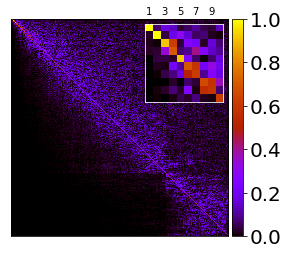

In [7]:
fig, ax0 = plt.subplots()
im=ax0.matshow(abs(ip[:-6, :-6]),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
axins = zoomed_inset_axes(ax0, zoom = 8, loc = 'upper right')
axins.matshow(abs(ip)[:10,:10], cmap = 'gnuplot')
axins.set_xticks([0, 2, 4, 6, 8])
axins.set_xticklabels([1, 3, 5, 7, 9])
axins.spines['bottom'].set_color('white')
axins.spines['top'].set_color('white')
axins.spines['left'].set_color('white')
axins.spines['right'].set_color('white')
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax,ticks=tics)
cbar.ax.tick_params(labelsize=20) 
#plt.savefig('../figures/overlap_final.pdf', dpi = 300)
plt.show()
plt.close()

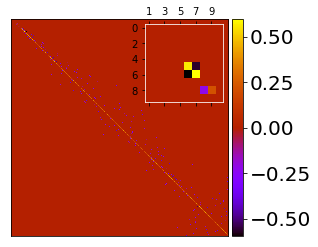

In [9]:
fig, ax0 = plt.subplots()
im=ax0.matshow(abs(ip[:-6, :-6]) - abs(dp_array[:-6, :-6]),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
axins = zoomed_inset_axes(ax0, zoom = 8, loc = 'upper right')
axins.matshow((abs(ip) - abs(dp_array))[:10,:10], cmap = 'gnuplot')
axins.set_xticks([0, 2, 4, 6, 8])
axins.set_xticklabels([1, 3, 5, 7, 9])
axins.spines['bottom'].set_color('white')
axins.spines['top'].set_color('white')
axins.spines['left'].set_color('white')
axins.spines['right'].set_color('white')
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax)
cbar.ax.tick_params(labelsize=20) 
#plt.savefig('../figures/overlap_final.pdf', dpi = 300)
plt.show()
plt.close()

In [15]:
summ = 0
for i in range(dp_array.shape[0]):
    summ += np.linalg.norm(dp_array[i,:])
print(summ)

228.0


In [32]:
np.diag(np.rad2deg(np.arccos(abs(dp_array)[:10,:10])))

array([ 2.41049555,  5.23928755, 23.10896942, 45.45104461, 22.93292775,
       53.67842295, 59.24853228, 48.17461175, 56.31925255, 51.89969191])

In [35]:
np.rad2deg(np.arccos(0.99))

8.109614455994183

In [33]:
np.diag(abs(dp_array)[:10,:10])

array([0.99911514, 0.99582202, 0.91976007, 0.70151843, 0.92096162,
       0.59231664, 0.5113151 , 0.66686273, 0.55456484, 0.61704011])

In [18]:
dpinv = np.linalg.inv(dp_array)

In [22]:
summ = np.zeros(dpinv.shape[0])
for i in range(dpinv.shape[0]):
    summ[i] = np.linalg.norm(dpinv[i,:])
print(summ)

[0.98978347 0.97788108 0.8877428  1.16280502 1.03017107 0.99667047
 1.09287359 0.9181383  1.081227   0.94184414 0.97931197 0.96187992
 0.89353696 0.97537203 1.01009554 0.96210011 0.89308055 0.94934994
 1.01052932 0.99807618 0.96349145 0.93798293 1.19190047 1.02987994
 0.96702821 0.97847128 0.97178149 0.9751622  1.22018157 1.15478307
 1.18329601 1.18778301 1.11151665 0.98296362 1.03498186 1.07700794
 1.04855213 1.15558366 1.06179943 1.15656309 1.02414598 1.10438017
 1.17166483 1.08008851 1.0356675  1.10789425 1.07604825 1.16107837
 1.02226741 1.24876412 1.11222125 1.08147815 1.18776496 1.11944053
 1.23463402 1.03277097 1.2056209  1.26600968 1.12946806 1.00012346
 1.11352031 1.12595518 1.18114548 1.17649043 1.22015142 1.19921267
 1.1572537  1.2636     1.19856763 1.13775133 1.27885656 1.15693479
 1.21950786 1.11938509 1.35621615 1.16144837 1.35404115 1.24371266
 1.27748001 1.19144335 1.21314821 1.23483715 1.20817167 1.23605806
 1.21400926 1.20139655 1.27528543 1.22155665 1.25572529 1.2271

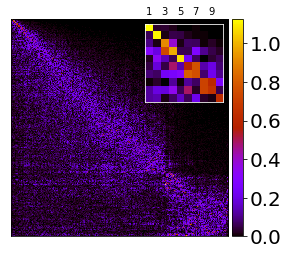

1.646288224209793


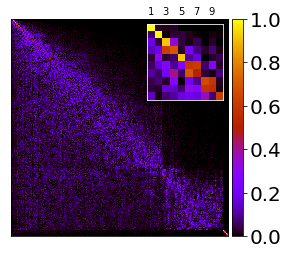

[  0   1   2   3   4   6   5   7   8   9  11  10  14  12  15  13  18  19
  20  21  16  20  17  22  23  16  29  28  27  26  12  21  24  25  34  13
  35  37  37  38  39  47  41  40  43  42  44  36  48  33  46  56  53  70
  55  62  51  45  40  61  65  54  63  73  59  79  71  52  50  78  74  83
  66  75  85  83  84  66  77  77  75  53  87  90  68  80  81  69  64  95
  60 101 103  45 118  89 108  70 102  57 110  24  93  97  80  92 121 114
  90 113  93  91  69 106 100 114  77  99  90 125 126 122 117 116 112  94
 129 124 132 136 130  98 113 134 139 128 109 155 138 135 130 147 137 142
 154 146 133 143 121 131 135 141 136 145 152 152 140 169 168 161 158 148
 148 159 159 160 175 163 164 213 167 170 165 171 176 174 177 162 221 180
 148 205 210 172 149 219 195 203 214 191 178 187 189 197 211 194 192 199
 212 215 218 182 217 178 194 183 179 183 195 184 216 202 197 188 199 197
 185 193 216 201 166 198]


In [5]:
#Overlap matrices with and without HI
#Calculate first to see how best to compare the modes
from mpl_toolkits.axes_grid1 import make_axes_locatable

n = nres = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
QINV = np.linalg.inv(Q)
QHAINV = np.linalg.inv(QHA)

dp_array = np.zeros_like(Q)
for i in range(Q.shape[1]):
    for j in range(QHAINV.shape[0]):
        dp_array[i,j] = np.dot(Q[:, i], QHAINV[j, :])
tics = [0.0,0.2,0.4,0.6,0.8,1.0]
L_overlap = np.matmul(Q, QHAINV)[:10, :10]

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(dp_array[:-6, :-6]),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
axins = zoomed_inset_axes(ax0, zoom = 8, loc = 'upper right')
axins.matshow(abs(dp_array)[:10,:10], cmap = 'gnuplot')
axins.set_xticks([0, 2, 4, 6, 8])
axins.set_xticklabels([1, 3, 5, 7, 9])
axins.spines['bottom'].set_color('white')
axins.spines['top'].set_color('white')
axins.spines['left'].set_color('white')
axins.spines['right'].set_color('white')
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax,ticks=tics)
cbar.ax.tick_params(labelsize=20) 
plt.savefig('../figures/overlap_all.pdf', dpi = 300)
plt.show()
plt.close()

'''fig, ax0 = plt.subplots()
im=ax0.matshow(abs(dp_array[:10, :10]),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax,ticks=tics)
cbar.ax.tick_params(labelsize=20) 
plt.show()
plt.close()'''
    
dp_array = np.zeros_like(Q)
for i in range(QHA.shape[1]):
    for j in range(QINV.shape[0]):
        dp_array[i,j] = np.dot(QHA[:, i], QINV[j, :])
print(np.trace(dp_array))
tics = [0.0,0.2,0.4,0.6,0.8,1.0]
L_overlap = np.matmul(QHA, QINV)[:10, :10]
fig, ax0 = plt.subplots()
im=ax0.matshow(abs(dp_array),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
axins = zoomed_inset_axes(ax0, zoom = 8, loc = 'upper right')
axins.matshow(abs(dp_array)[:10,:10], cmap = 'gnuplot')
axins.set_xticks([0, 2, 4, 6, 8])
axins.set_xticklabels([1, 3, 5, 7, 9])
axins.spines['bottom'].set_color('white')
axins.spines['top'].set_color('white')
axins.spines['left'].set_color('white')
axins.spines['right'].set_color('white')
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax,ticks=tics)
cbar.ax.tick_params(labelsize=20) 
plt.savefig('../figures/overlap_HI.pdf', dpi = 300)
plt.show()
plt.close()

order = []
for i in range(3*nres - 6):
    #print(abs(dp_array[i, :]).argmax())
    #print(np.argsort(abs(dp_array[i, :]))[-1])
    #print('\n')
    if np.any(order == np.argsort(abs(dp_array[i, :]))[-1]):
        order.append(np.argsort(abs(dp_array[i, :]))[-2])
    else:
        order.append(abs(dp_array[i, :]).argmax())
order = np.array(order)
print(order)

In [71]:
np.trace(abs(dp_array[:10, :10]))

7.479276709159376

In [74]:
(np.trace(abs(dp_array)) - np.trace(abs(dp_array[:10, :10])))

27.365910223031005

In [79]:
np.rad2deg(np.arccos(0.97))

14.069867747572133

In [75]:
(np.trace(abs(dp_array)) - np.trace(abs(dp_array[:10, :10]))) / 212

0.1290844821841085

In [11]:
print(np.diagonal(abs(dp_array[:, :])).sum())
print(np.diagonal(abs(dp_array[:10, :10])).sum())

34.84518693219038
7.479276709159376


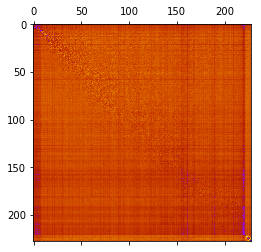

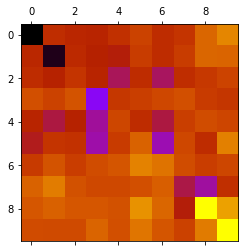

[  0   1 220   3   3   6 221   8   7  11]


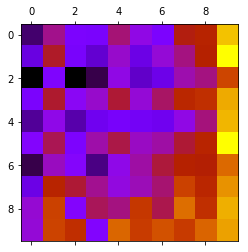

[104 140 226 222 138 222 227 225 140 140]


In [64]:
#Overlap matrices with and without HI
#Calculate first to see how best to compare the modes
from mpl_toolkits.axes_grid1 import make_axes_locatable

n = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
QINV = np.linalg.inv(Q)
QHAINV = np.linalg.inv(QHA)

MN_array = np.zeros_like(Q)
for i in range(Q.shape[1]):
    for j in range(QHAINV.shape[0]):
        MN_array[i,j] = manhattan_norm(Q[:, i], QHA[:, j])

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(MN_array[:, :]),cmap = 'gnuplot')
#ax0.set_xticks([])
#ax0.set_yticks([])
#divider = make_axes_locatable(ax0)
#cax = divider.append_axes("right", size="5%", pad=0.05)
#cbar = plt.colorbar(im, cax=cax,ticks=tics)
#cbar.ax.tick_params(labelsize=20) 
#plt.savefig('../figures/overlap_all.pdf', dpi = 300)
plt.show()
plt.close()

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(MN_array[:10, :10]),cmap = 'gnuplot')
plt.show()
plt.close()
    
order = []
for i in range(10):
    #print(abs(dp_array[i, :]).argmax())
    #print(np.argsort(abs(dp_array[i, :]))[-1])
    #print('\n')
    #if np.any(order == np.argsort(abs(dp_array[i, :]))[-1]):
    order.append(np.argmin(MN_array[i, :]))

order = np.array(order)
print(order)
MN_array = np.zeros_like(Q)
for i in range(QHA.shape[1]):
    for j in range(QINV.shape[0]):
        MN_array[i,j] = manhattan_norm(QINV[i, :], QHAINV[:, j])

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(MN_array[:10, :10]),cmap = 'gnuplot')

plt.savefig('../figures/overlap_HI.pdf', dpi = 300)
plt.show()
plt.close()

order = []
for i in range(10):
    #print(abs(dp_array[i, :]).argmax())
    #print(np.argsort(abs(dp_array[i, :]))[-1])
    #print('\n')
    #if np.any(order == np.argsort(abs(dp_array[i, :]))[-1]):
    order.append(np.argmin(MN_array[i, :]))

order = np.array(order)
print(order)

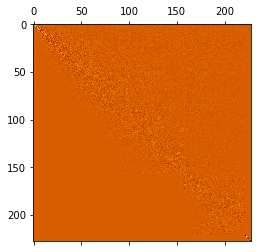

[ 0  1  6  3  5  6  8  7  7 11]


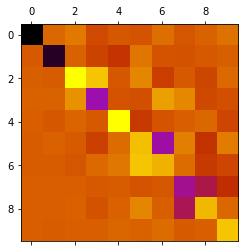

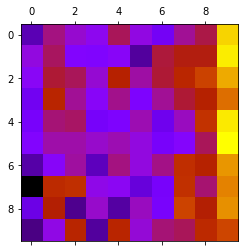

[138 227 139 140 138 138 138 139 138 139]


In [63]:
#Overlap matrices with and without HI
#Calculate first to see how best to compare the modes
from mpl_toolkits.axes_grid1 import make_axes_locatable

n = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
QINV = np.linalg.inv(Q)
QHAINV = np.linalg.inv(QHA)

l2_array = np.zeros_like(Q)
for i in range(Q.shape[1]):
    for j in range(QHAINV.shape[0]):
        l2_array[i,j] = l2_norm(Q[:, i], QHA[:, j])

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(l2_array[:, :]),cmap = 'gnuplot')
#ax0.set_xticks([])
#ax0.set_yticks([])
#divider = make_axes_locatable(ax0)
#cax = divider.append_axes("right", size="5%", pad=0.05)
#cbar = plt.colorbar(im, cax=cax,ticks=tics)
#cbar.ax.tick_params(labelsize=20) 
#plt.savefig('../figures/overlap_all.pdf', dpi = 300)
plt.show()
plt.close()

order = []
for i in range(10):
    #print(abs(dp_array[i, :]).argmax())
    #print(np.argsort(abs(dp_array[i, :]))[-1])
    #print('\n')
    #if np.any(order == np.argsort(abs(dp_array[i, :]))[-1]):
    order.append(np.argmin(l2_array[i, :]))

order = np.array(order)
print(order)

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(l2_array[:10, :10]),cmap = 'gnuplot')
plt.show()
plt.close()
    
l2_array = np.zeros_like(Q)
for i in range(QHA.shape[1]):
    for j in range(QINV.shape[0]):
        l2_array[i,j] = l2_norm(QINV[i, :], QHAINV[:, j])

fig, ax0 = plt.subplots()
im=ax0.matshow(abs(l2_array[:10, :10]),cmap = 'gnuplot')

plt.savefig('../figures/overlap_HI.pdf', dpi = 300)
plt.show()
plt.close()

order = []
for i in range(10):
    #print(abs(dp_array[i, :]).argmax())
    #print(np.argsort(abs(dp_array[i, :]))[-1])
    #print('\n')
    #if np.any(order == np.argsort(abs(dp_array[i, :]))[-1]):
    order.append(np.argmin(l2_array[i, :]))

order = np.array(order)
print(order)

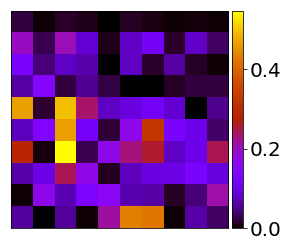

[2, 0, 52, 44, 0, 11, 17, 3, 37, 6, 17, 3, 30, 12, 9, 10, 12, 118, 43, 33, 157, 26, 16, 157, 15, 16, 13, 15, 143, 22, 184, 127, 174, 167, 50, 32, 170, 172, 51, 42, 157, 158, 26, 51, 189, 109, 209, 52, 28, 152, 166, 166, 180, 59, 191, 133, 167, 209, 211, 217, 189, 196, 218, 220, 215, 134, 215, 141, 218, 203, 187, 220, 210, 212, 144, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [9]:
#Overlap with the isotropic Q matrix
#Compare with hydrodynamics, since the isotropic version includes HI as well

n = 76
M = np.reshape(np.loadtxt('../../Mmatrix'), (n, n))[1:, :]
#Convert to the eigenvectors of the HA matrix for comparison with PCA modes.
M = np.reshape(np.loadtxt('../../Mmatrix'), (n, n))
QLE4PD = np.reshape(np.loadtxt('../../Qmatrix'), (n - 1, n - 1))
Q_sorted = np.reshape(np.loadtxt('../../Qmatrix'), (n - 1, n - 1))
QN_guess = np.matmul(np.linalg.pinv(M)[:, 1:], QLE4PD)
for i in range(QN_guess.shape[1]):
    QN_guess[:, i] = QN_guess[:, i] / np.linalg.norm(QN_guess[:, i])
dummy = np.zeros((n, n))
dummy[:, 0] = 1 / n
dummy[:, 1:] = QN_guess 
QN_guess = dummy
QLE4PD = QN_guess

#Kronecker product with (1, 1, 1)^T and renormalize to compare with anisotropic model
Q3N = np.kron(QLE4PD.T, np.ones(3)).T

for i in range(Q3N.shape[1]):
    Q3N[:, i] = Q3N[:, i] / np.linalg.norm(Q3N[:, i])
#Q3NINV = np.linalg.inv(Q3N)
    
dp_array = np.zeros_like(QHA)
for i in range(Q3N.shape[1]):
    for j in range(QHAINV.shape[0]):
        dp_array[i,j] = np.dot(Q3N[:, i], QHAINV[j, :])
tics = [0.0,0.2,0.4,0.6,0.8,1.0]
L_overlap = np.matmul(QHA, QINV)[:10, :10]
fig, ax0 = plt.subplots()
im=ax0.matshow(abs(dp_array[:10, :10]),cmap = 'gnuplot')
ax0.set_xticks([])
ax0.set_yticks([])
divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(im, cax=cax,ticks=tics)
cbar.ax.tick_params(labelsize=20) 
#plt.savefig('../overlap_HI.pdf', dpi = 300)
plt.show()
plt.close()

iso_order = []
for i in range(3*nres - 6):
    #print(abs(dp_array[i, :]).argmax())
    #print(np.argsort(abs(dp_array[i, :]))[-1])
    #print('\n')
    if np.any(order == np.argsort(abs(dp_array[i, :-6]))[-1]):
        iso_order.append(np.argsort(abs(dp_array[i, :-6]))[-2])
    else:
        iso_order.append(abs(dp_array[i, :-6]).argmax())
print(iso_order)
iso_order = np.array(iso_order)

In [31]:
np.diagonal(abs(dp_array[:10,:10]))

array([0.99911514, 0.99582202, 0.91976007, 0.70151843, 0.92096162,
       0.59231664, 0.5113151 , 0.66686273, 0.55456484, 0.61704011])

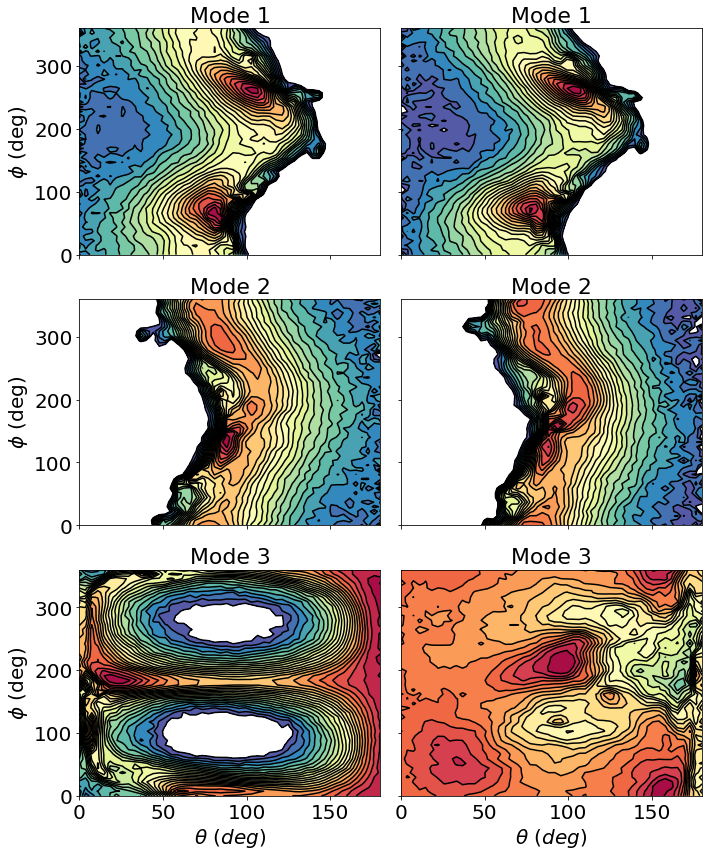

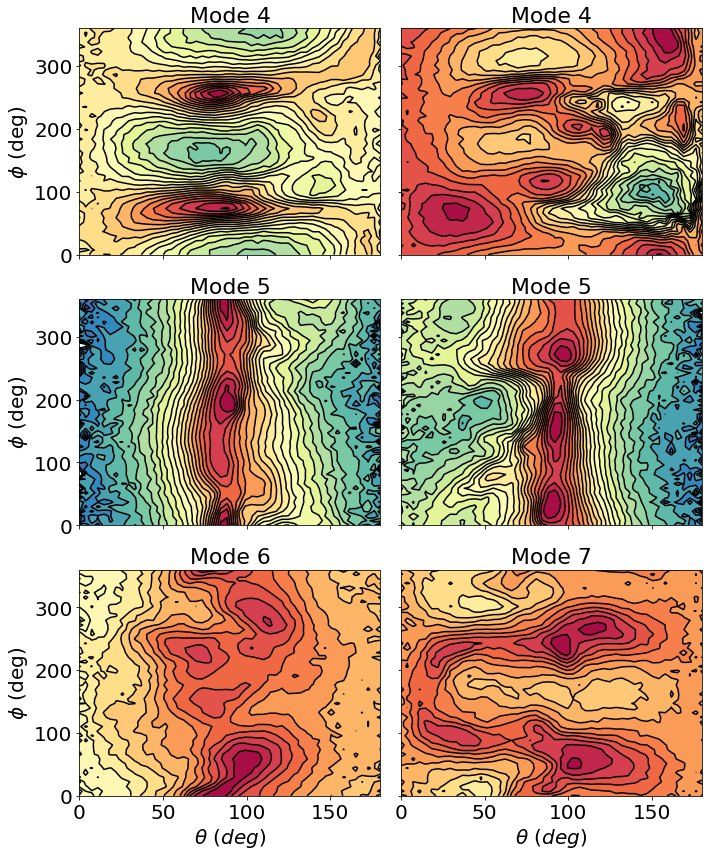

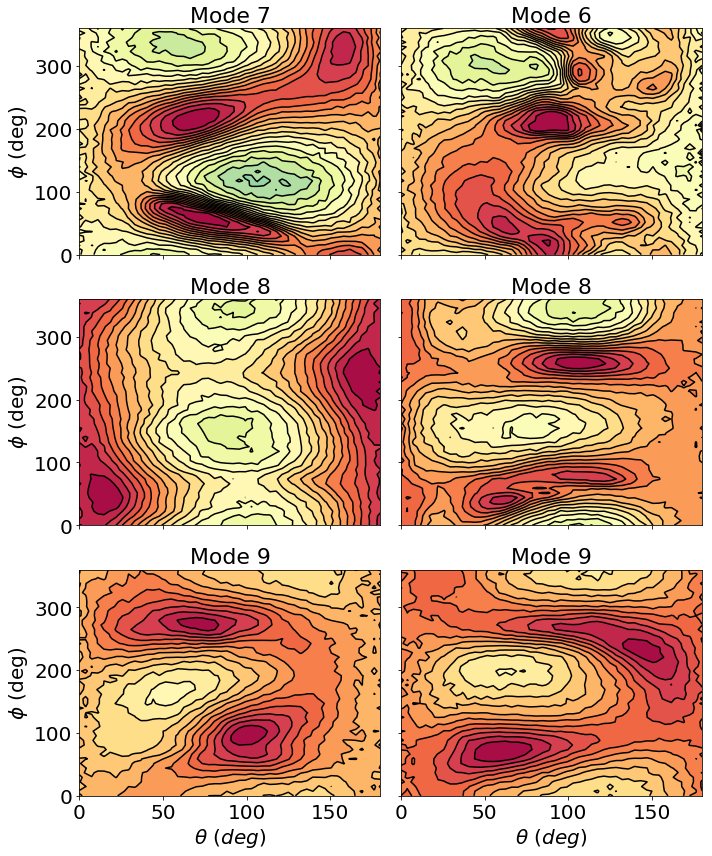

In [27]:
#Compare free-energy surfaces with and without HI
fig, ((ax0, ax1),(ax2, ax3), (ax4, ax5)) = plt.subplots(nrows = 3, ncols = 2, figsize=(10, 12), sharex=True, sharey=True)
nbins = 100

fes_min = 0
fes_max = 5
fes = np.load('../fes1.npy')
ext1 = [0, 180, 0, 360]
im0=ax0.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax0.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax0.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax0.set_title('Mode 1',fontsize=22)
ax0.tick_params(labelsize=20)

fes = np.load('../fes_HA1.npy')
im0=ax1.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax1.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax1.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax1.set_title('Mode 1',fontsize=22)
ax1.tick_params(labelsize=20)

fes = np.load('../fes2.npy')
im0=ax2.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax2.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax2.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax2.set_title('Mode 2',fontsize=22)
ax2.tick_params(labelsize=20)

fes = np.load('../fes_HA2.npy')
im0=ax3.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax3.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax3.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax3.set_title('Mode 2',fontsize=22)
ax3.tick_params(labelsize=20)

fes = np.load('../fes3.npy')
im0=ax4.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax4.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax4.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax4.set_title('Mode 3',fontsize=22)
ax4.tick_params(labelsize=20)
ax4.set_xlabel(r'$\theta\ (deg)$',fontsize=20)

fes = np.load('../fes_HA3.npy')
im0=ax5.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax5.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax5.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax5.set_title('Mode 3',fontsize=22)
ax5.tick_params(labelsize=20)
ax5.set_xlabel(r'$\theta\ (deg)$',fontsize=20)

plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
plt.savefig('../figures/fes_first_three.pdf',dpi=1000)
plt.show()
plt.close()


fig, ((ax0, ax1),(ax2, ax3), (ax4, ax5)) = plt.subplots(nrows = 3, ncols = 2, figsize=(10, 12), sharex=True, sharey=True)
nbins = 100

fes = np.load('../fes4.npy')
ext1 = [0, 180, 0, 360]
im0=ax0.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax0.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax0.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax0.set_title('Mode 4',fontsize=22)
ax0.tick_params(labelsize=20)

fes = np.load('../fes_HA4.npy')
im0=ax1.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax1.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax1.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax1.set_title('Mode 4',fontsize=22)
ax1.tick_params(labelsize=20)

fes = np.load('../fes5.npy')
im0=ax2.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax2.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax2.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax2.set_title('Mode 5',fontsize=22)
ax2.tick_params(labelsize=20)

fes = np.load('../fes_HA5.npy')
im0=ax3.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax3.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax3.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax3.set_title('Mode 5',fontsize=22)
ax3.tick_params(labelsize=20)

fes = np.load('../fes6.npy')
im0=ax4.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax4.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax4.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax4.set_title('Mode 6',fontsize=22)
ax4.tick_params(labelsize=20)
ax4.set_xlabel(r'$\theta\ (deg)$',fontsize=20)

#Flip-flop modes 6 and 7 when HI are included due to mode overlaps
fes = np.load('../fes_HA7.npy')
im0=ax5.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax5.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax5.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax5.set_title('Mode 7',fontsize=22)
ax5.tick_params(labelsize=20)
ax5.set_xlabel(r'$\theta\ (deg)$',fontsize=20)

plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
plt.savefig('../figures/fes_next_three.pdf',dpi=1000)
plt.show()
plt.close()


fig, ((ax0, ax1),(ax2, ax3), (ax4, ax5)) = plt.subplots(nrows = 3, ncols = 2, figsize=(10, 12), sharex=True, sharey=True)
nbins = 100

fes = np.load('../fes7.npy')
ext1 = [0, 180, 0, 360]
im0=ax0.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax0.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax0.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax0.set_title('Mode 7',fontsize=22)
ax0.tick_params(labelsize=20)

fes = np.load('../fes_HA6.npy')
im0=ax1.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax1.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax1.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax1.set_title('Mode 6',fontsize=22)
ax1.tick_params(labelsize=20)

fes = np.load('../fes8.npy')
im0=ax2.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax2.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax2.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax2.set_title('Mode 8',fontsize=22)
ax2.tick_params(labelsize=20)

fes = np.load('../fes_HA8.npy')
im0=ax3.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax3.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax3.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax3.set_title('Mode 8',fontsize=22)
ax3.tick_params(labelsize=20)

fes = np.load('../fes9.npy')
im0=ax4.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax4.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
ax4.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax4.set_title('Mode 9',fontsize=22)
ax4.tick_params(labelsize=20)
ax4.set_xlabel(r'$\theta\ (deg)$',fontsize=20)

fes = np.load('../fes_HA9.npy')
im0=ax5.contourf(fes,zorder=-13,levels=np.linspace(fes_min, fes_max,nbins//4),cmap='Spectral',extent=ext1)
ax5.contour(fes,zorder=-12,levels=np.linspace(fes_min, fes_max,nbins//4),colors='k',extent=ext1)
#ax0.set_xlabel(r'$\theta\ (deg)$')
#ax5.set_ylabel(r'$\phi$ (deg)',fontsize=20)
ax5.set_title('Mode 9',fontsize=22)
ax5.tick_params(labelsize=20)
ax5.set_xlabel(r'$\theta\ (deg)$',fontsize=20)

plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
plt.savefig('../figures/fes_three_more.pdf',dpi=1000)
plt.show()
plt.close()

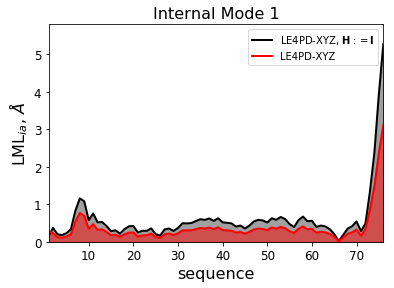

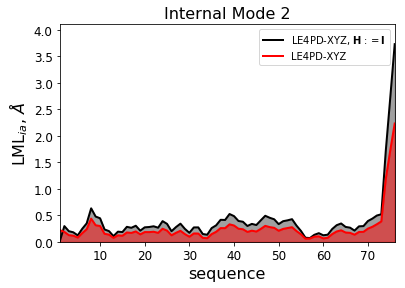

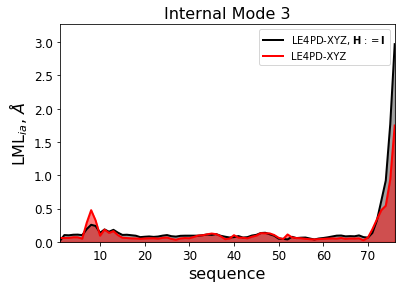

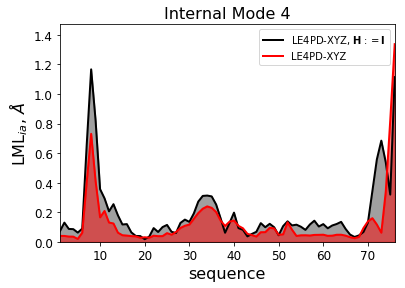

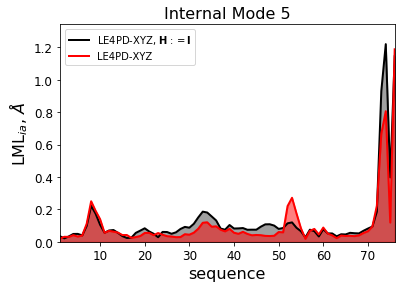

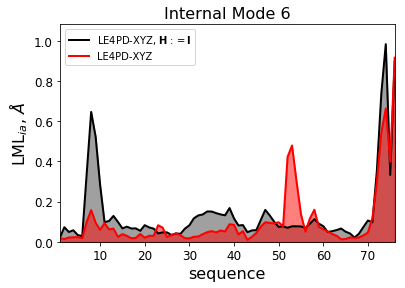

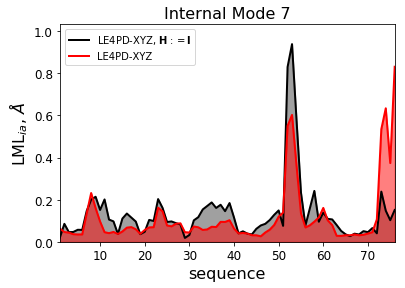

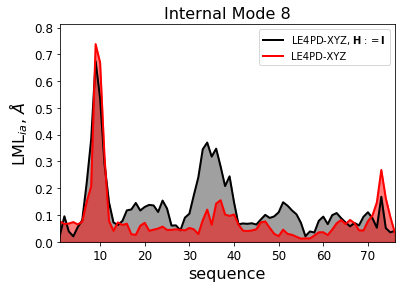

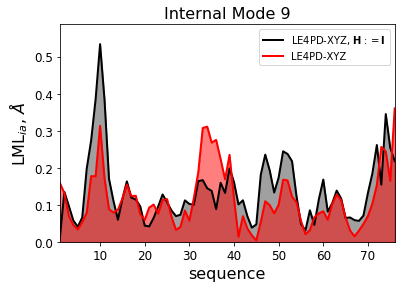

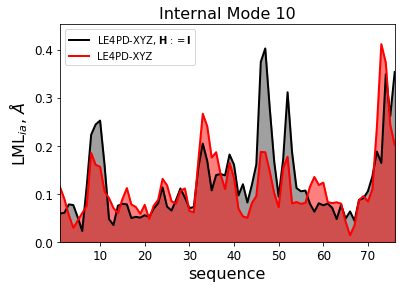

In [6]:
#Local Mode Lengthscale -- observe the effects of HI

PATH = '../'
PATH_LE4PD = '../../lml/'

N = 76

lml = np.zeros((N, 3*N))
lml_HA = np.zeros((N, 3*N))
lml_le4pd = np.zeros((N, 3*N))

for i in range(1,50):
    lml[:,i - 1] = np.loadtxt(PATH + 'lml_' + str(i) + '.dat')
    lml_HA[:, i - 1] = np.loadtxt(PATH + 'HC_lml_' + str(i) + '.dat')
    dummy = np.loadtxt(PATH_LE4PD + 'lml_' + str(i + 3) + '.dat')
    lml_le4pd[1:, i - 1] = np.loadtxt(PATH_LE4PD + 'lml_' + str(i + 3) + '.dat')
    lml[0, i - 1] = dummy[0]
    
for a in range(10):
    plt.plot(np.arange(1, 77),lml[:,a], lw = 2, c = 'k', label = r'LE4PD-XYZ, $\mathbf{H}:=\mathbf{I}$')
    plt.fill_between(np.arange(1, 77), 0, lml[:,a], color = 'grey', alpha = 0.75)
    plt.plot(np.arange(1, 77),lml_HA[:,order[a]], lw = 2, c = 'r', label = 'LE4PD-XYZ')
    plt.fill_between(np.arange(1, 77), 0, lml_HA[:,order[a]], color = 'r', alpha = 0.5)
    #plt.plot(np.arange(1, 77),lml_le4pd[:,a], lw = 2, c = 'b', label = 'LE4PD')
    #plt.fill_between(np.arange(1, 77), 0, lml_le4pd[:,a], color = 'b', alpha = 0.25)
    plt.xlabel('sequence', fontsize = 16)
    plt.ylabel(r'LML$_{ia}$, $\AA$', fontsize = 16)
    plt.xticks(size = 12)
    plt.yticks(size = 12)
    plt.xlim((1, 76))
    plt.ylim((0, 1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,a].max()]))))
    plt.title('Internal Mode '+str(a + 1), fontsize = 16)
    plt.legend()
    #plt.savefig('../figures/no_iso_lml_comp_mode' + str(a + 1) + '.pdf', dpi = 300)
    plt.show()
    plt.close()

In [47]:
#Local Mode Lengthscale -- observe the effects of HI

PATH = '../'
PATH_LE4PD = '../../lml/'

N = 76

Q = np.reshape(np.loadtxt('../com_HCmatrix'), (3*N, 3*N))
eigvals = np.loadtxt('../com_covar_eig')

lml = np.zeros((N, 3*N))
lml_HA = np.zeros((N, 3*N))
lml_le4pd = np.zeros((N, 3*N))

for a in range(3*N):
    num = 0
    for i in range(0, 3*N, 3):
        lml_HA[num, a] = (Q[i, a]**2 + Q[i+1, a]**2 + Q[i+2, a]**2)*eigvals[a]*100
        num += 1
lml_HA = np.sqrt(lml_HA)
        
for i in range(1, 3*N + 1):
    lml[:,i - 1] = np.loadtxt(PATH + 'lml_' + str(i) + '.dat')
    #lml_HA[:, i - 1] = np.loadtxt(PATH + 'HC_lml_' + str(i) + '.dat')
    #dummy = np.loadtxt(PATH_LE4PD + 'lml_' + str(i + 3) + '.dat')
    #lml_le4pd[1:, i - 1] = np.loadtxt(PATH_LE4PD + 'lml_' + str(i + 3) + '.dat')
    #lml[0, i - 1] = dummy[0]

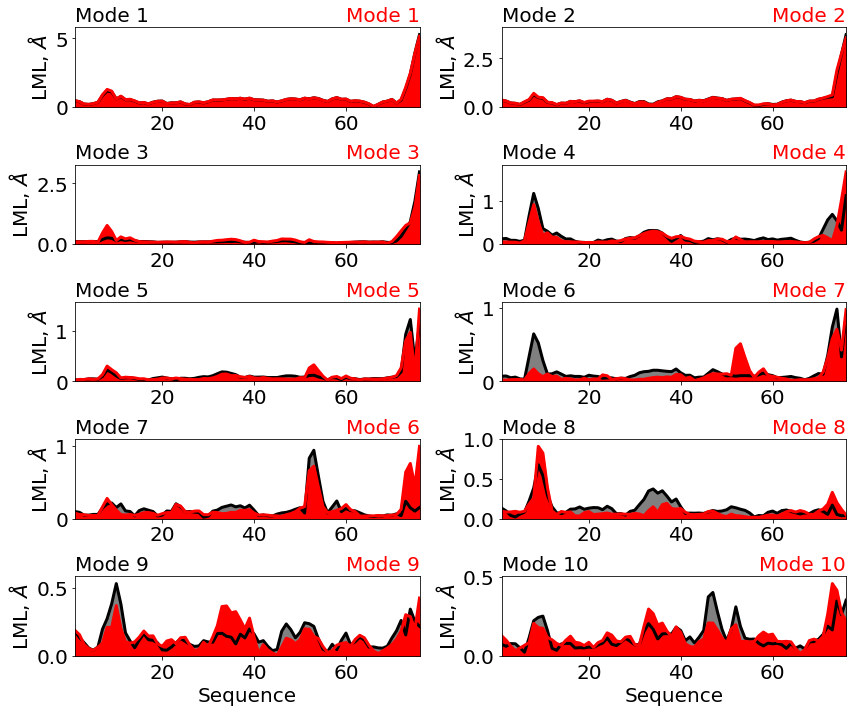

In [51]:
fig,((ax0,ax1),(ax2,ax3),(ax4,ax5),(ax6,ax7),(ax8,ax9)) = plt.subplots(5,2,figsize=(12,10),sharex=False,
                                                                       sharey=False)

a = 0
ax0.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax0.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax0.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax0.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax0.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax0.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax0.set_ylabel(r'LML, $\AA$',fontsize=20)
ax0.set_xlim((1,76))
ax0.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax0.tick_params(labelsize=20)

a = 1
ax1.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax1.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax1.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax1.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax1.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax1.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax1.set_ylabel(r'LML, $\AA$',fontsize=20)
ax1.set_xlim((1,76))
ax1.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax1.tick_params(labelsize=20)

a = 2
ax2.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax2.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax2.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax2.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax2.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax2.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax2.set_ylabel(r'LML, $\AA$',fontsize=20)
ax2.set_xlim((1,76))
ax2.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax2.tick_params(labelsize=20)

a = 3
ax3.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax3.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax3.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax3.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax3.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax3.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax3.set_ylabel(r'LML, $\AA$',fontsize=20)
ax3.set_xlim((1,76))
ax3.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax3.tick_params(labelsize=20)

a = 4
ax4.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax4.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax4.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax4.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax4.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax4.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax4.set_ylabel(r'LML, $\AA$',fontsize=20)
ax4.set_xlim((1,76))
ax4.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax4.tick_params(labelsize=20)

a = 5
ax5.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax5.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax5.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax5.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax5.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax5.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax5.set_ylabel(r'LML, $\AA$',fontsize=20)
ax5.set_xlim((1,76))
ax5.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax5.tick_params(labelsize=20)

a = 6
ax6.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax6.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax6.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax6.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax6.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax6.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax6.set_ylabel(r'LML, $\AA$',fontsize=20)
ax6.set_xlim((1,76))
ax6.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax6.tick_params(labelsize=20)

a = 7
ax7.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax7.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax7.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax7.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax7.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax7.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
#ax0.set_xlabel('Sequence',fontsize=20)
ax7.set_ylabel(r'LML, $\AA$',fontsize=20)
ax7.set_xlim((1,76))
ax7.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax7.tick_params(labelsize=20)

a = 8
ax8.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax8.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax8.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax8.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax8.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax8.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
ax8.set_xlabel('Sequence',fontsize=20)
ax8.set_ylabel(r'LML, $\AA$',fontsize=20)
ax8.set_xlim((1,76))
ax8.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax8.tick_params(labelsize=20)

a = 9
ax9.set_title('Mode ' + str(a + 1),fontsize=20, loc = 'left')
ax9.set_title('Mode ' + str(order[a] + 1), fontsize = 20, loc = 'right', color = 'r')
ax9.plot(np.arange(1,77),lml[:,a],c='k',lw=3)
ax9.fill_between(np.arange(1,77),0,lml[:,a],color='grey')
ax9.plot(np.arange(1,77),lml_HA[:,order[a]],c='r',lw=3)
ax9.fill_between(np.arange(1,77),0,lml_HA[:,order[a]],color='r')
ax9.set_xlabel('Sequence',fontsize=20)
ax9.set_ylabel(r'LML, $\AA$',fontsize=20)
ax9.set_xlim((1,76))
ax9.set_ylim((0,1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,order[a]].max()]))))
ax9.tick_params(labelsize=20)
    
    
plt.tight_layout()
#plt.xlim((1,77))
#plt.set_ylim((0,lml[:,a].max()*1.1))
plt.savefig('../figures/lml_slow_two_titles.pdf', dpi = 300)
plt.show()
plt.close()

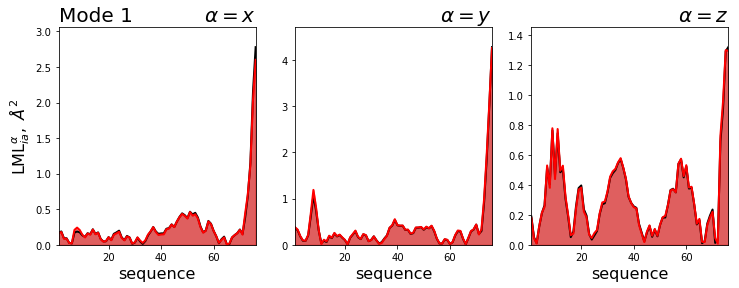

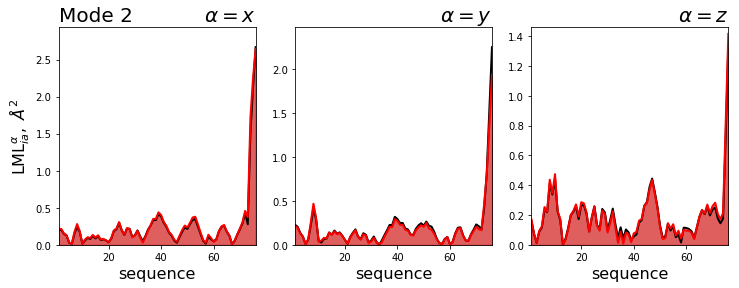

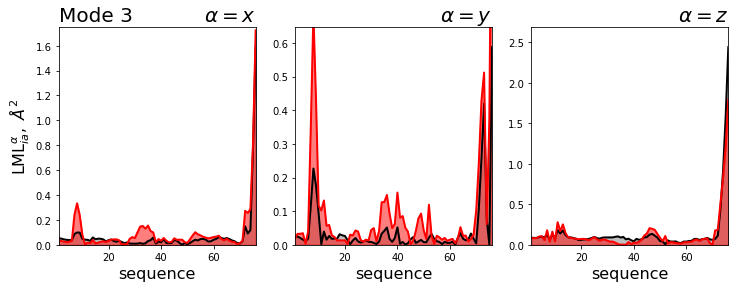

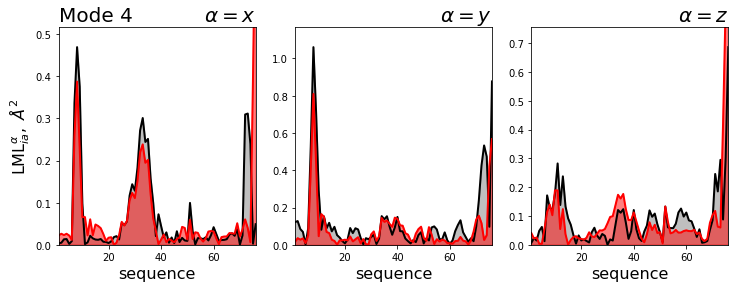

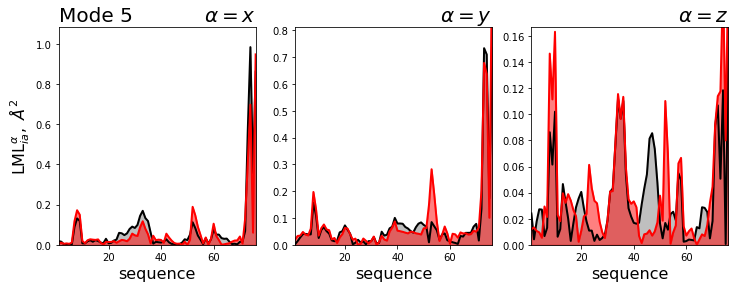

...

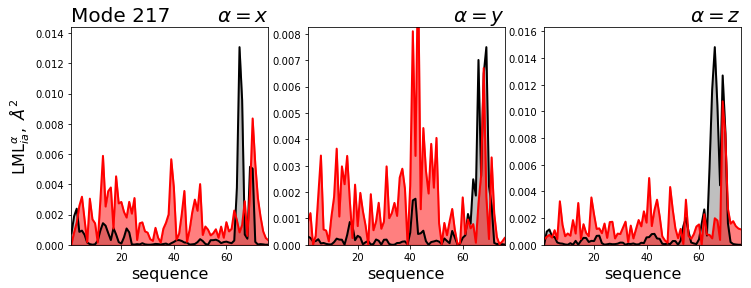

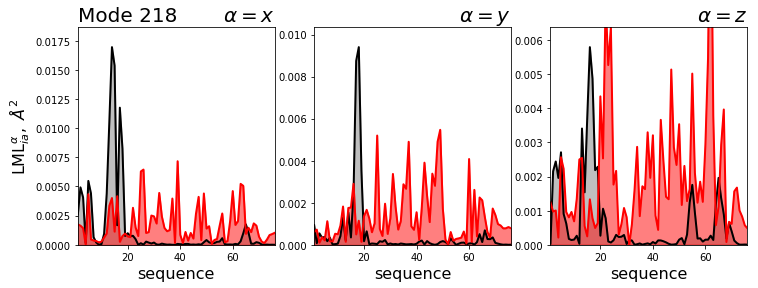

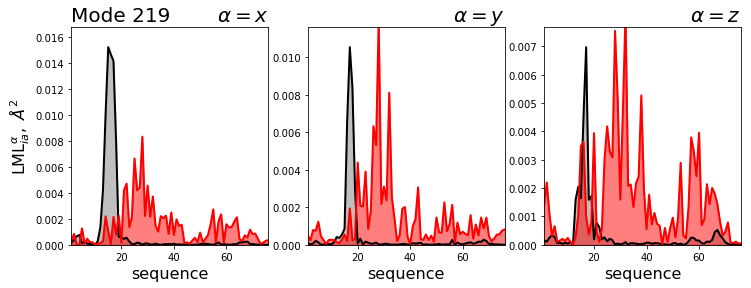

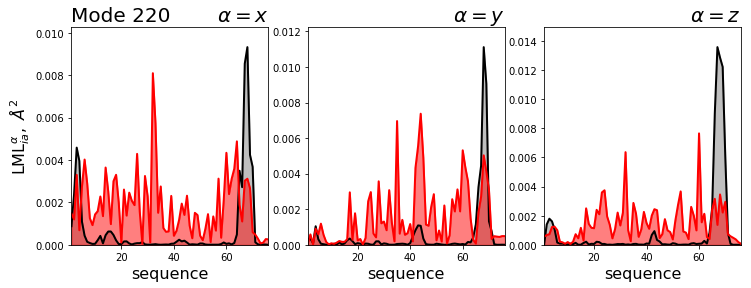

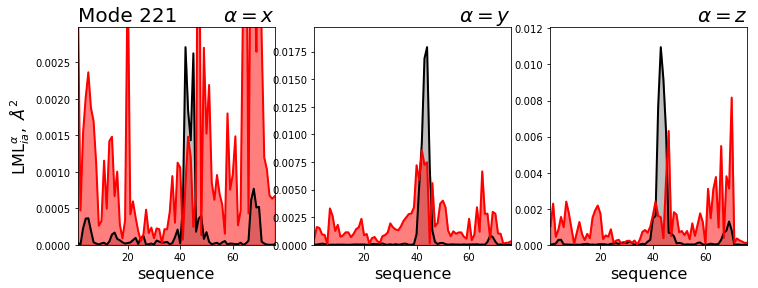

In [52]:
#Anisotropic LML

lamb = np.loadtxt('../com_covar_eig')
lamb_HA = np.loadtxt('../com_HC_eig')
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (228, 228))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (228, 228))

nimages = 11
nres = 76
for mode in range(1, 3*nres - 6):
    
    fig, (ax0, ax1, ax2) = plt.subplots(nrows = 1, ncols = 3, figsize = (12, 4), sharey = False)


    lml_x = np.sqrt((Q[::3,:]**2)[:, mode - 1]*lamb[mode - 1]*100)
    lml_y = np.sqrt((Q[1::3,:]**2)[:, mode - 1]*lamb[mode - 1]*100)
    lml_z = np.sqrt((Q[2::3,:]**2)[:, mode - 1]*lamb[mode - 1]*100)
    ax0.plot(np.arange(1, nres + 1), lml_x, lw = 2, c = 'k', label = 'lml')
    ax0.fill_between(np.arange(1, nres + 1), 0, lml_x, color = 'grey', alpha = 0.5)
    ax1.plot(np.arange(1, nres + 1), lml_y, lw = 2, c = 'k', label = 'lml')
    ax1.fill_between(np.arange(1, nres + 1), 0, lml_y, color = 'grey', alpha = 0.5)
    ax2.plot(np.arange(1, nres + 1), lml_z, lw = 2, c = 'k', label = 'lml')
    ax2.fill_between(np.arange(1, nres + 1), 0, lml_z, color = 'grey', alpha = 0.5)
    
    ax0.set_ylim((0, 1.1*lml_x.max()))
    ax1.set_ylim((0, 1.1*lml_y.max()))
    ax2.set_ylim((0, 1.1*lml_z.max()))
    
    lml_x = np.sqrt((QHA[::3,:]**2)[:, order[mode - 1]]*lamb[mode - 1]*100)
    lml_y = np.sqrt((QHA[1::3,:]**2)[:, order[mode - 1]]*lamb[mode - 1]*100)
    lml_z = np.sqrt((QHA[2::3,:]**2)[:, order[mode - 1]]*lamb[mode - 1]*100)
    ax0.plot(np.arange(1, nres + 1), lml_x, lw = 2, c = 'r', label = 'lml')
    ax0.fill_between(np.arange(1, nres + 1), 0, lml_x, color = 'r', alpha = 0.5)
    ax1.plot(np.arange(1, nres + 1), lml_y, lw = 2, c = 'r', label = 'lml')
    ax1.fill_between(np.arange(1, nres + 1), 0, lml_y, color = 'r', alpha = 0.5)
    ax2.plot(np.arange(1, nres + 1), lml_z, lw = 2, c = 'r', label = 'lml')
    ax2.fill_between(np.arange(1, nres + 1), 0, lml_z, color = 'r', alpha = 0.5)
    
    ax0.set_title('Mode ' + str(mode), fontsize = 20, loc = 'left')
    ax0.set_title(r'$\alpha = x$', fontsize = 20, loc = 'right')
    ax1.set_title(r'$\alpha = y$', fontsize = 20, loc = 'right')
    ax2.set_title(r'$\alpha = z$', fontsize = 20, loc = 'right')
    ax0.set_xlim((1, nres))
    ax1.set_xlim((1, nres))
    ax2.set_xlim((1, nres))
    ax0.set_xlabel('sequence', fontsize = 16)
    ax1.set_xlabel('sequence', fontsize = 16)
    ax2.set_xlabel('sequence', fontsize = 16)
    ax0.set_ylabel(r'LML$^{\alpha}_{ia},\ \AA^2$', fontsize = 16)
    #plt.legend()
    if mode <= 10:
        plt.savefig('../figures/aniso_lml_mode' + str(mode) + '.pdf', dpi = 300)
    plt.show()
    plt.close()

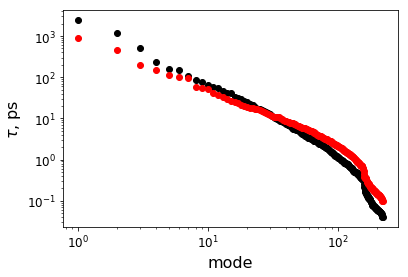

In [11]:
#Diffusive timescales

tau = np.loadtxt('../tau_3N.dat')
tau_HA = np.loadtxt('../tau_3N_HA.dat')

plt.plot(tau[:-6, 0], tau[:-6, 1], lw = 0, marker = 'o', color = 'k')
plt.plot(tau_HA[:-6, 0], tau_HA[:-6, 1], lw = 0, marker = 'o', color = 'r')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('mode', fontsize = 16)
plt.ylabel(r'$\tau$, ps', fontsize = 16)
plt.xticks(size = 12)
plt.yticks(size = 12)
plt.show()
plt.close()

0.999280384708068 0.9995458882614917 0.9994922258238264


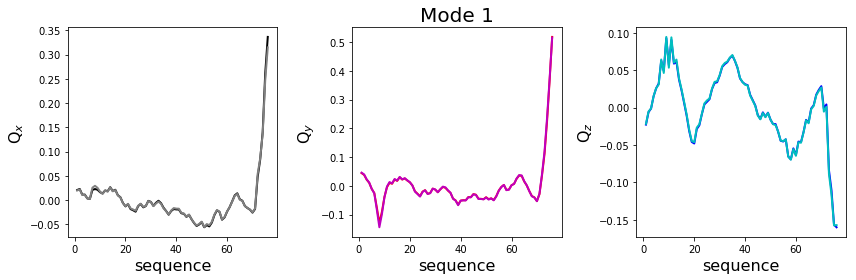

0.9984709026867994 0.9976865086685188 0.9977835482090257


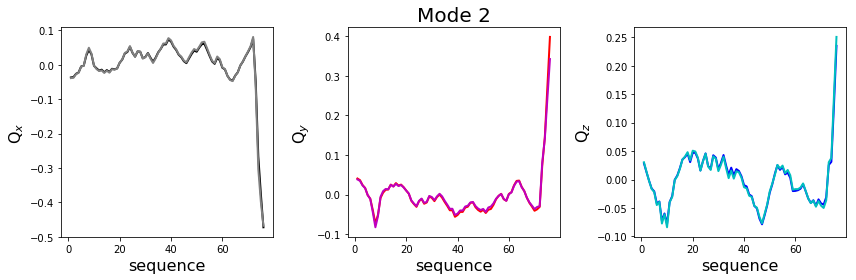

0.967380319812717 0.9270440352776411 0.980909549033365


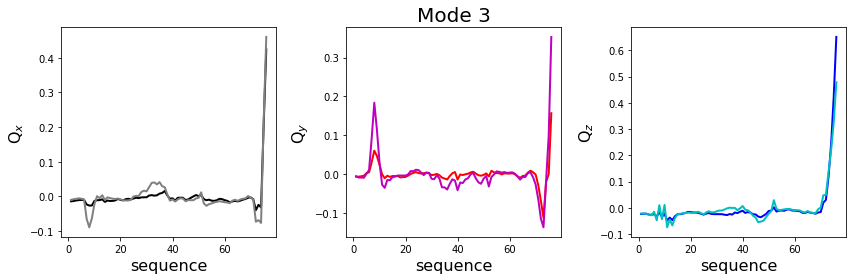

0.5299497757643559 0.8352191017788317 0.7692388504448503


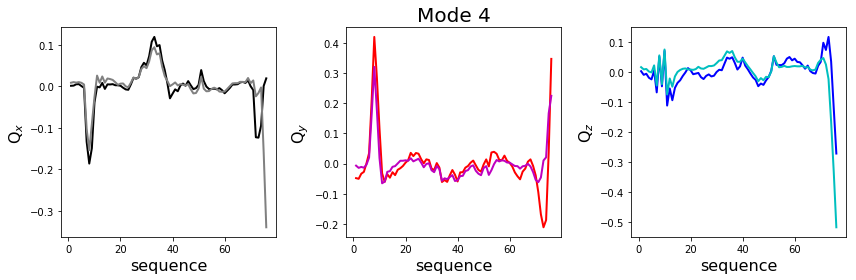

0.9426138307650828 0.9384922130783777 0.7450379486038575


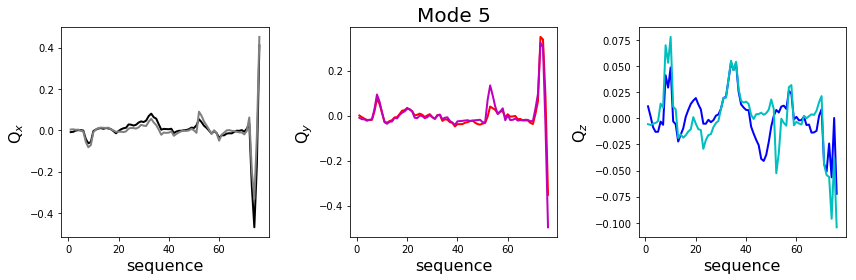

0.7940884539822106 0.6701385620412847 0.6540841702963628


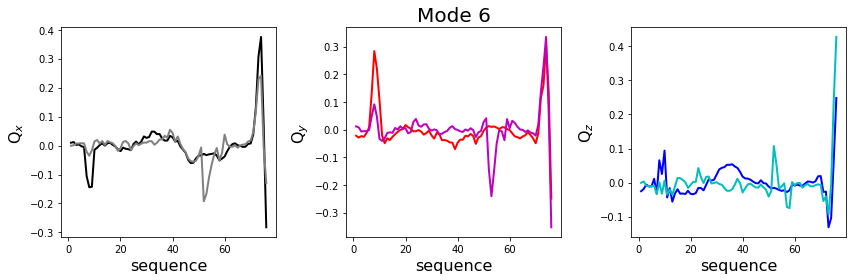

0.6110374387246271 0.745931760607089 0.49407472911460565


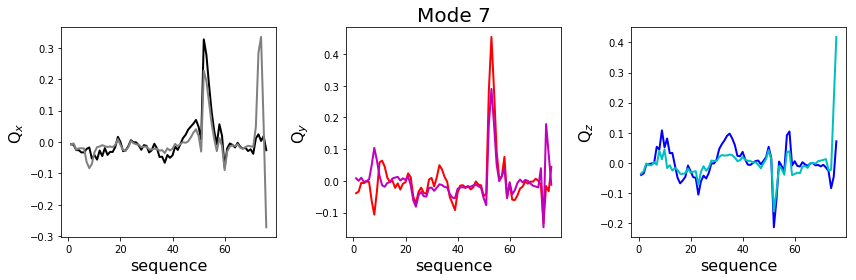

0.6664464132988529 0.6099360104618067 0.8042046915411167


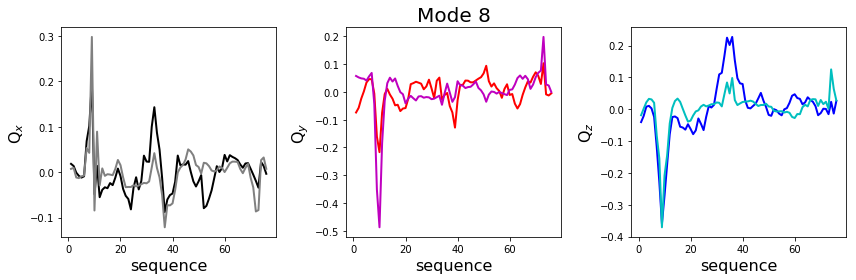

0.3562060242837835 0.7350512344089507 0.4915438726513174


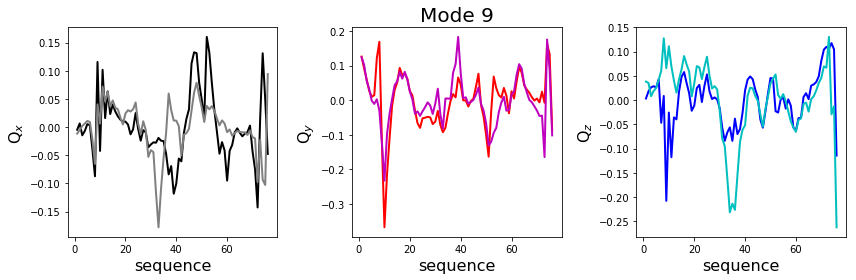

0.6313088502157074 0.6115036375835515 0.6476083477345007


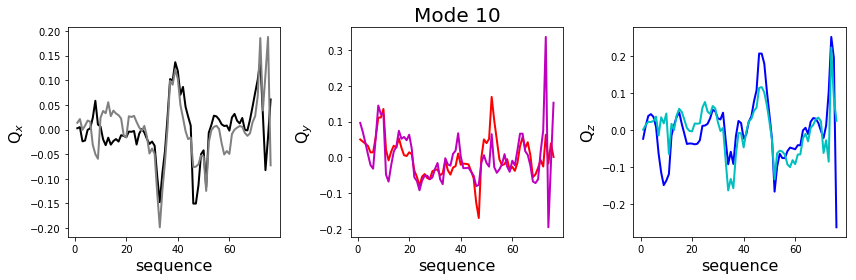

IndexError: index 10 is out of bounds for axis 0 with size 10

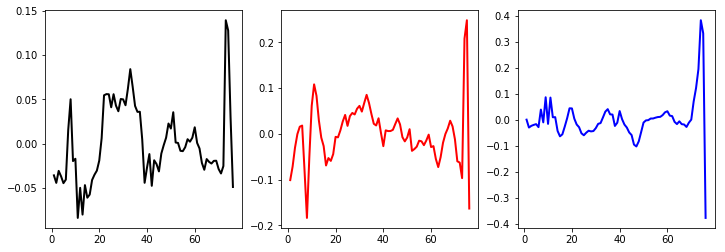

In [48]:
#Eigenvector perturbations due to HI

n = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
xcorr = np.zeros(3*n - 6)
ycorr = np.zeros(3*n - 6)
zcorr = np.zeros(3*n - 6)
for i in range(11): #3*n - 6):
    fig, (ax0, ax1, ax2) = plt.subplots(nrows = 1, ncols = 3, figsize = (12, 4), sharey = False, sharex = True)
    ax0.plot(np.arange(1, n + 1), Q[::3, i], lw = 2, c = 'k')
    ax1.plot(np.arange(1, n + 1), Q[1::3, i], lw = 2, c = 'r')
    ax2.plot(np.arange(1, n + 1), Q[2::3, i], lw = 2, c = 'b')
    
    if (i == 2) or (i == 4) or (i == 6) or (i == 8) or (i == 9):
        ax0.plot(np.arange(1, n + 1), -1*QHA[::3, order[i]], lw = 2, c = 'grey')
        ax1.plot(np.arange(1, n + 1), -1*QHA[1::3, order[i]], lw = 2, c = 'm')
        ax2.plot(np.arange(1, n + 1), -1*QHA[2::3, order[i]], lw = 2, c = 'c')
        
        xcorr[i] = np.corrcoef(Q[::3, i], -1*QHA[::3, order[i]])[0,1]
        ycorr[i] = np.corrcoef(Q[1::3, i], -1*QHA[1::3, order[i]])[0,1]
        zcorr[i] = np.corrcoef(Q[2::3, i], -1*QHA[2::3, order[i]])[0,1]
        print(xcorr[i], ycorr[i], zcorr[i])
    else:
        ax0.plot(np.arange(1, n + 1), QHA[::3, order[i]], lw = 2, c = 'grey')
        ax1.plot(np.arange(1, n + 1), QHA[1::3, order[i]], lw = 2, c = 'm')
        ax2.plot(np.arange(1, n + 1), QHA[2::3, order[i]], lw = 2, c = 'c')
        
        xcorr[i] = np.corrcoef(Q[::3, i], QHA[::3, order[i]])[0,1]
        ycorr[i] = np.corrcoef(Q[1::3, i], QHA[1::3, order[i]])[0,1]
        zcorr[i] = np.corrcoef(Q[2::3, i], QHA[2::3, order[i]])[0,1]
        print(xcorr[i], ycorr[i], zcorr[i])
        
    ax0.set_xlabel('sequence', fontsize = 16)
    ax1.set_xlabel('sequence', fontsize = 16)
    ax2.set_xlabel('sequence', fontsize = 16)
    
    ax0.set_ylabel(r'Q$_x$', fontsize = 16)
    ax1.set_ylabel(r'Q$_y$', fontsize = 16)
    ax2.set_ylabel(r'Q$_z$', fontsize = 16)
    ax1.set_title('Mode ' + str(i + 1), fontsize = 20)
    plt.tight_layout()
    plt.savefig('../figures/eigenvector_comp_mode' + str(i + 1) + '.pdf', dpi = 300)
    plt.show()
    plt.close()
    
plt.plot(xcorr, lw = 2, c = 'k')
plt.plot(ycorr, lw = 2, c = 'r')
plt.plot(zcorr, lw = 2, c = 'b')
plt.show()
plt.close()

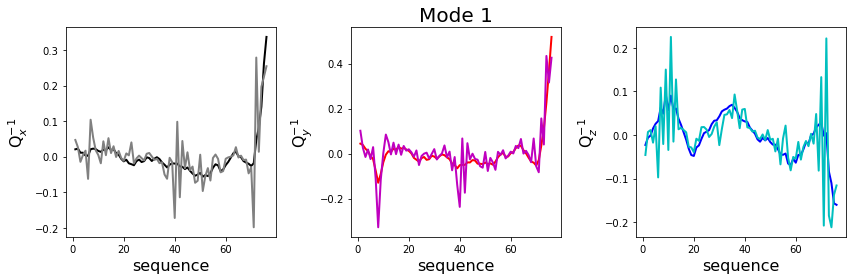

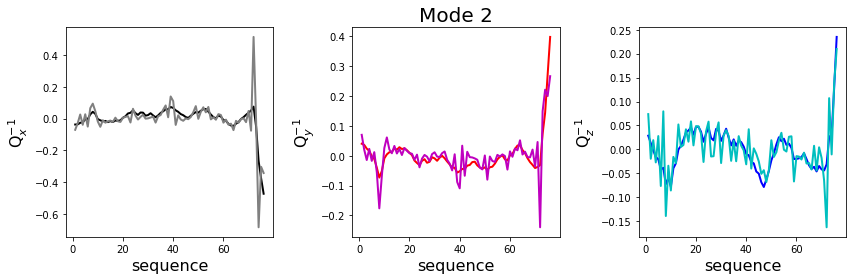

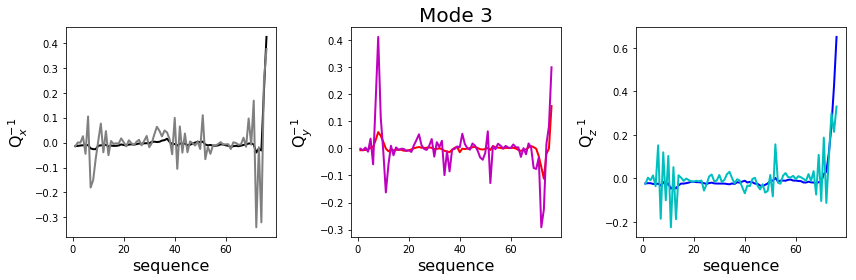

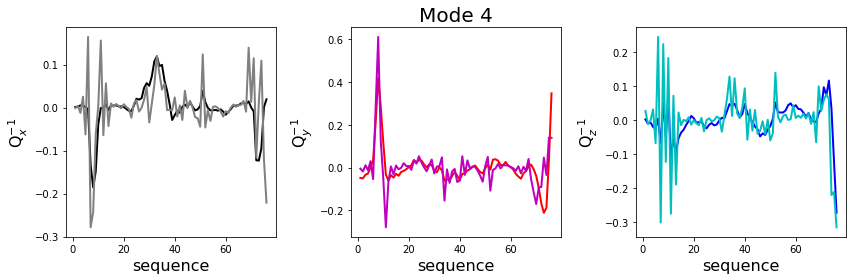

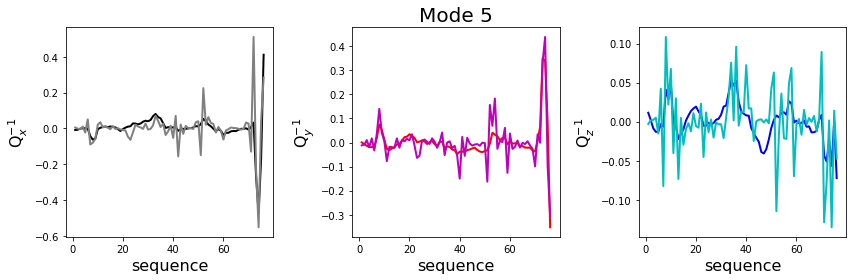

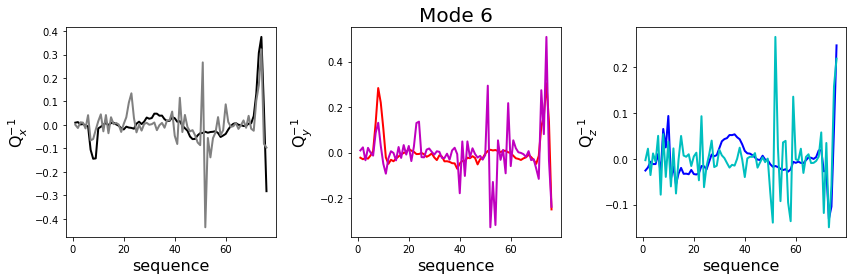

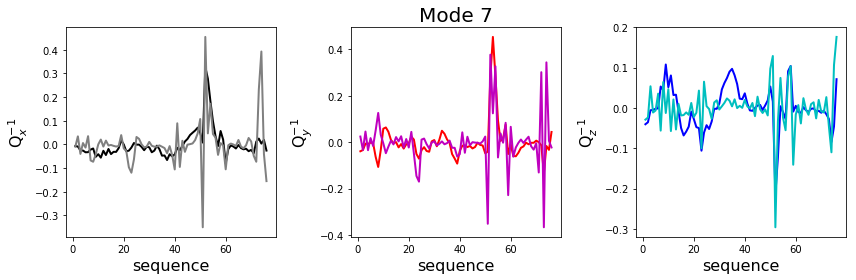

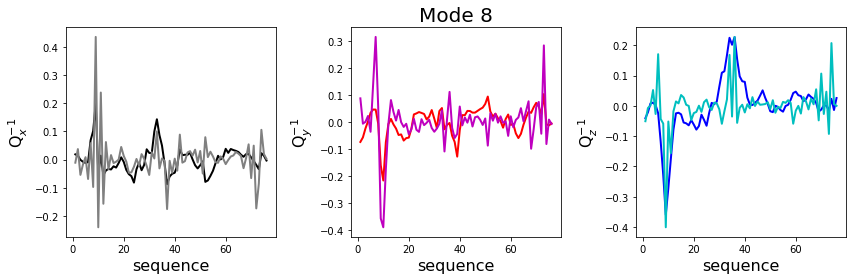

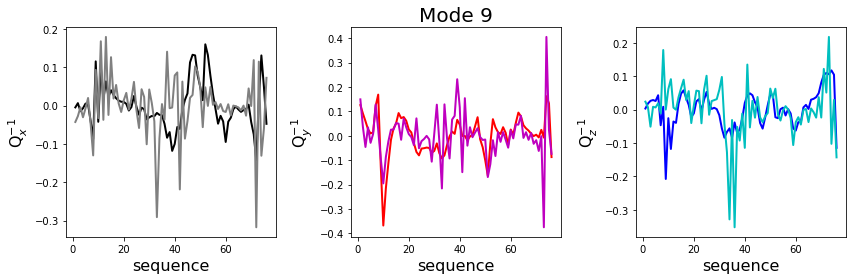

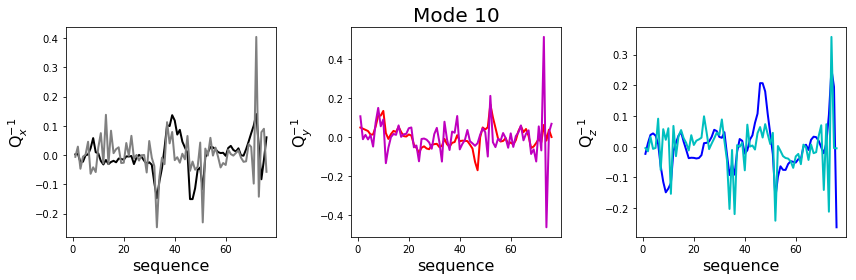

IndexError: index 10 is out of bounds for axis 0 with size 10

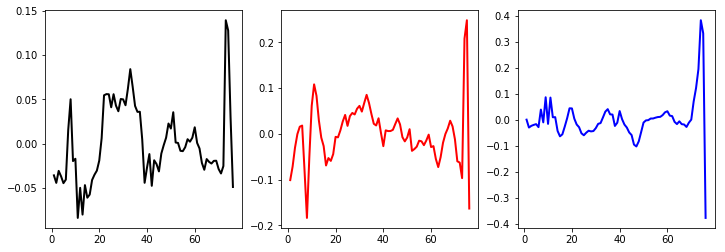

In [24]:
#Eigenvector perturbations due to HI

n = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
xcorr = np.zeros(3*n - 6)
ycorr = np.zeros(3*n - 6)
zcorr = np.zeros(3*n - 6)
for i in range(11): #3*n - 6):
    fig, (ax0, ax1, ax2) = plt.subplots(nrows = 1, ncols = 3, figsize = (12, 4), sharey = False, sharex = True)
    ax0.plot(np.arange(1, n + 1), QINV[i, ::3], lw = 2, c = 'k')
    ax1.plot(np.arange(1, n + 1), QINV[i, 1::3], lw = 2, c = 'r')
    ax2.plot(np.arange(1, n + 1), QINV[i, 2::3], lw = 2, c = 'b')
    
    if (i == 2) or (i == 4) or (i == 6) or (i == 8) or (i == 9):
        ax0.plot(np.arange(1, n + 1), -1*QHAINV[order[i], ::3], lw = 2, c = 'grey')
        ax1.plot(np.arange(1, n + 1), -1*QHAINV[order[i], 1::3], lw = 2, c = 'm')
        ax2.plot(np.arange(1, n + 1), -1*QHAINV[order[i], 2::3], lw = 2, c = 'c')
        
    else:
        ax0.plot(np.arange(1, n + 1), QHAINV[order[i], ::3], lw = 2, c = 'grey')
        ax1.plot(np.arange(1, n + 1), QHAINV[order[i], 1::3], lw = 2, c = 'm')
        ax2.plot(np.arange(1, n + 1), QHAINV[order[i], 2::3], lw = 2, c = 'c')
        
    ax0.set_xlabel('sequence', fontsize = 16)
    ax1.set_xlabel('sequence', fontsize = 16)
    ax2.set_xlabel('sequence', fontsize = 16)
    
    ax0.set_ylabel(r'Q$^{-1}_x$', fontsize = 16)
    ax1.set_ylabel(r'Q$^{-1}_y$', fontsize = 16)
    ax2.set_ylabel(r'Q$^{-1}_z$', fontsize = 16)
    ax1.set_title('Mode ' + str(i + 1), fontsize = 20)
    plt.tight_layout()
    #plt.savefig('../figures/eigenvector_comp_mode' + str(i + 1) + '.pdf', dpi = 300)
    plt.show()
    plt.close()
    
plt.plot(xcorr, lw = 2, c = 'k')
plt.plot(ycorr, lw = 2, c = 'r')
plt.plot(zcorr, lw = 2, c = 'b')
plt.show()
plt.close()

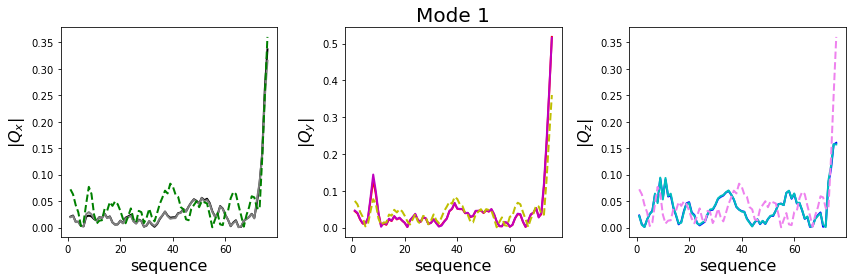

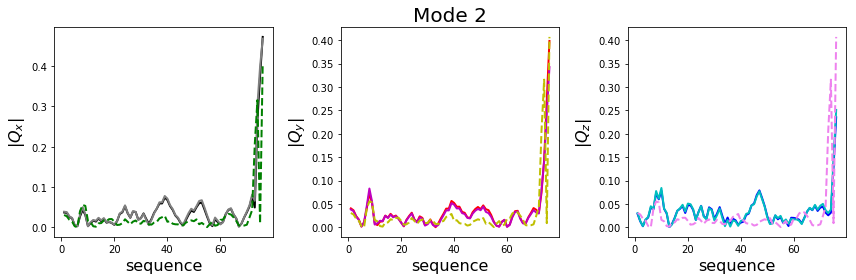

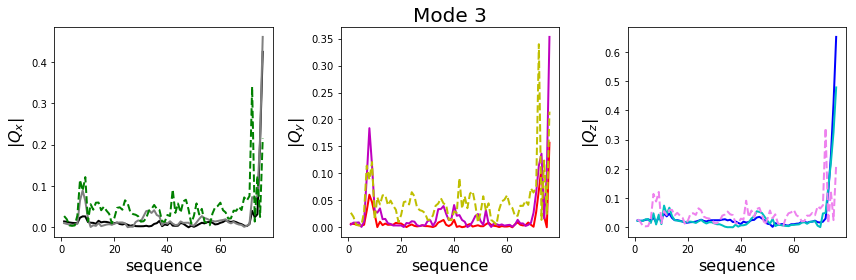

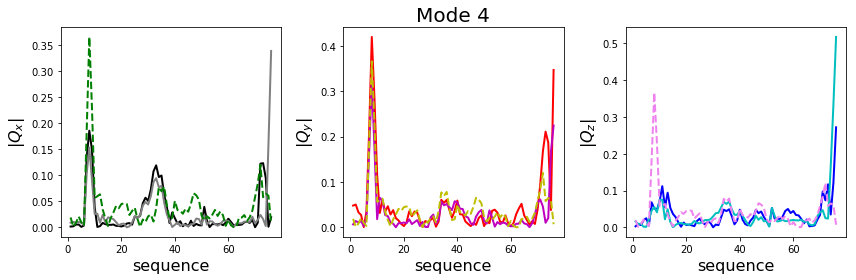

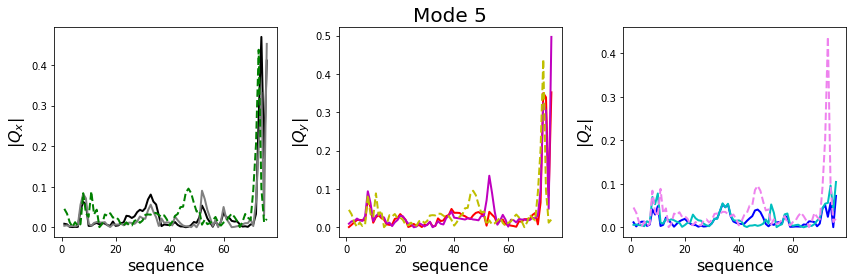

...

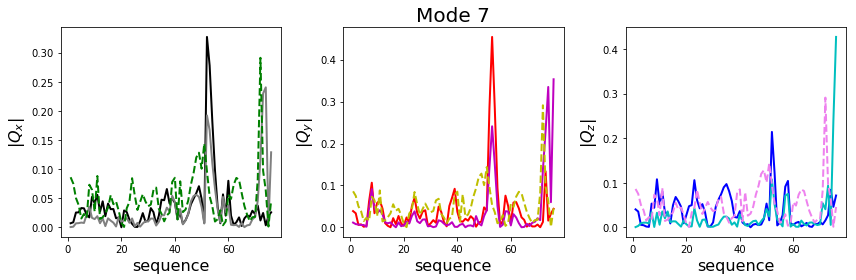

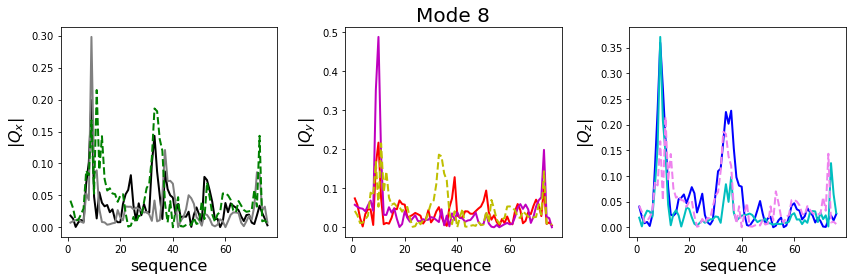

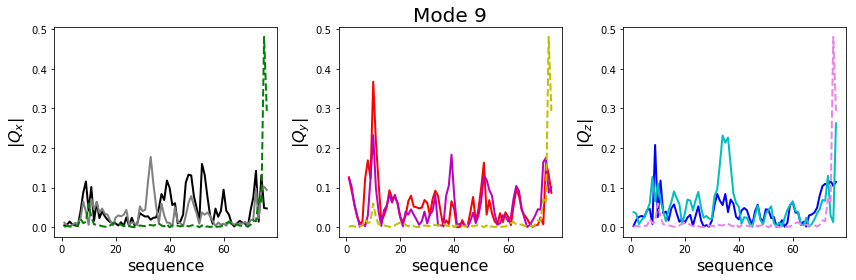

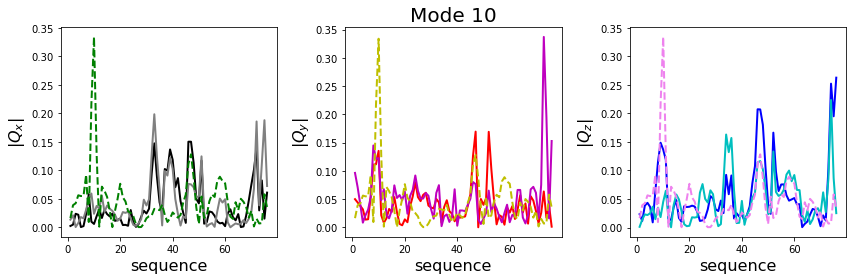

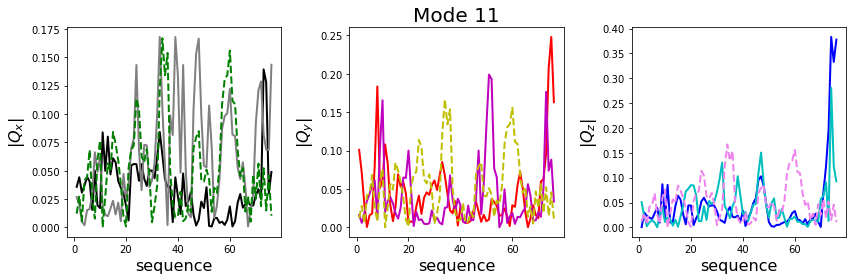

In [9]:
#Eigenvector perturbations due to HI, plus differences compared to isotropic LE4PD model

n = 76
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*n, 3*n))
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (3*n, 3*n))
QLE4PD = np.reshape(np.loadtxt('../../Qmatrix'), (n - 1, n - 1))
M = np.reshape(np.loadtxt('../../Mmatrix'), (n, n))[1:, :]
#Convert to the eigenvectors of the HA matrix for comparison with PCA modes.
M = np.reshape(np.loadtxt('../../Mmatrix'), (n, n))
Q_sorted = np.reshape(np.loadtxt('../../Qmatrix'), (n - 1, n - 1))
QN_guess = np.matmul(np.linalg.pinv(M)[:, 1:], QLE4PD)
for i in range(QN_guess.shape[1]):
    QN_guess[:, i] = QN_guess[:, i] / np.linalg.norm(QN_guess[:, i])
dummy = np.zeros((n, n))
dummy[:, 0] = 1 / n
dummy[:, 1:] = QN_guess 
QN_guess = dummy
QLE4PD = QN_guess

#Kronecker product with (1, 1, 1)^T and renormalize to compare with anisotropic model
Q3N = np.kron(QLE4PD.T, np.ones(3)).T

for i in range(Q3N.shape[1]):
    Q3N[:, i] = Q3N[:, i] / np.linalg.norm(Q3N[:, i])

xcorr = np.zeros(3*n - 6)
ycorr = np.zeros(3*n - 6)
zcorr = np.zeros(3*n - 6)
for i in range(11):
    fig, (ax0, ax1, ax2) = plt.subplots(nrows = 1, ncols = 3, figsize = (12, 4), sharey = False, sharex = True)
    ax0.plot(np.arange(1, n + 1), abs(Q[::3, i]), lw = 2, c = 'k')
    ax1.plot(np.arange(1, n + 1), abs(Q[1::3, i]), lw = 2, c = 'r')
    ax2.plot(np.arange(1, n + 1), abs(Q[2::3, i]), lw = 2, c = 'b')
    
    ax0.plot(np.arange(1, n + 1), abs(QHA[::3, i]), lw = 2, c = 'grey')
    ax1.plot(np.arange(1, n + 1), abs(QHA[1::3, i]), lw = 2, c = 'm')
    ax2.plot(np.arange(1, n + 1), abs(QHA[2::3, i]), lw = 2, c = 'c')

    #xcorr[i] = np.corrcoef(Q[::3, i], -1*QHA[::3, i])[0,1]
    #ycorr[i] = np.corrcoef(Q[1::3, i], -1*QHA[1::3, i])[0,1]
    #zcorr[i] = np.corrcoef(Q[2::3, i], -1*QHA[2::3, i])[0,1]
    #print(xcorr[i], ycorr[i], zcorr[i])
        
    ax0.plot(np.arange(1, n + 1), abs(Q3N[::3, i + 4]), lw = 2, c = 'g', ls = '--')
    ax1.plot(np.arange(1, n + 1), abs(Q3N[1::3, i + 4]), lw = 2, c = 'y', ls = '--')
    ax2.plot(np.arange(1, n + 1), abs(Q3N[2::3, i + 4]), lw = 2, c = 'violet', ls = '--')
        
    ax0.set_xlabel('sequence', fontsize = 16)
    ax1.set_xlabel('sequence', fontsize = 16)
    ax2.set_xlabel('sequence', fontsize = 16)
    
    ax0.set_ylabel(r'$\vert Q_{x}\vert$', fontsize = 16)
    ax1.set_ylabel(r'$\vert Q_{y}\vert$', fontsize = 16)
    ax2.set_ylabel(r'$\vert Q_{z}\vert$', fontsize = 16)
    ax1.set_title('Mode '+ str(i + 1), fontsize = 20)
    
    plt.savefig('../figures/isotropic_eigenvector_comp_mode' + str(i + 1) + '.pdf', dpi = 300)
    plt.tight_layout()
    plt.show()
    plt.close()
    
#plt.plot(xcorr, lw = 2, c = 'k')
#plt.plot(ycorr, lw = 2, c = 'r')
#plt.plot(zcorr, lw = 2, c = 'b')
#plt.show()
#plt.close()

[0.48046832 0.07461332 0.28441868 0.17520654 0.07336448 0.03005741
 0.19020284 0.39742678 0.14508251 0.10288539] 

[0.46722464 0.1431541  0.54742526 0.1745351  0.16158933 0.43240252
 0.1867385  0.03377932 0.03855135 0.00385798] 



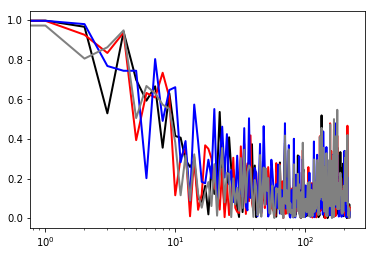

In [36]:
#Inner products of the slow modes

QINV = np.linalg.inv(Q)
QHAINV = np.linalg.inv(QHA)
dp0 = []
dp1 = []
dp2 = []

for i in range(10):
    dp0.append(abs(np.dot(Q3N[:, i + 4], QINV[i, :])))
    dp1.append(abs(np.dot(Q3N[:, i + 4], QHAINV[i, :])))
for i in range(3*n - 6):
    dp2.append(abs(np.dot(Q[:, i], QHAINV[i, :])))
dp0 = np.array(dp0)
dp1 = np.array(dp1)
dp2 = np.array(dp2)
print(dp0, "\n")
print(dp1, "\n")
#print(dp2)

plt.plot(abs(xcorr), lw = 2, c = 'k')
plt.plot(abs(ycorr), lw = 2, c = 'r')
plt.plot(abs(zcorr), lw = 2, c = 'b')
plt.plot(dp2, lw = 2, c = 'grey')
plt.xscale('log')
plt.show()
plt.close()

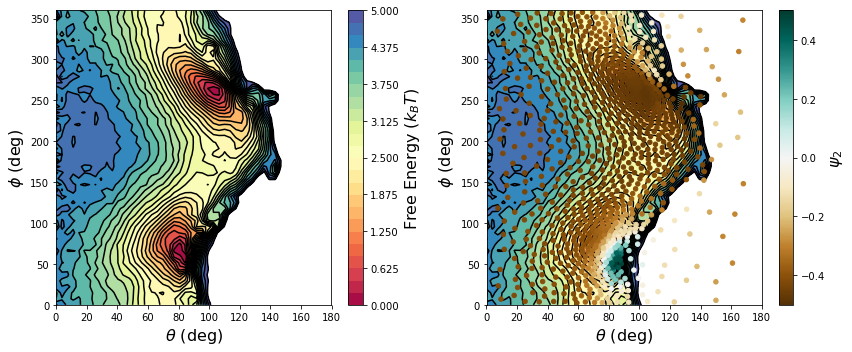

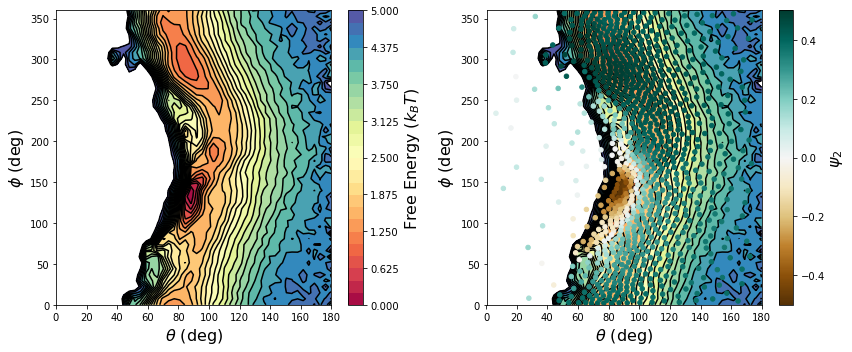

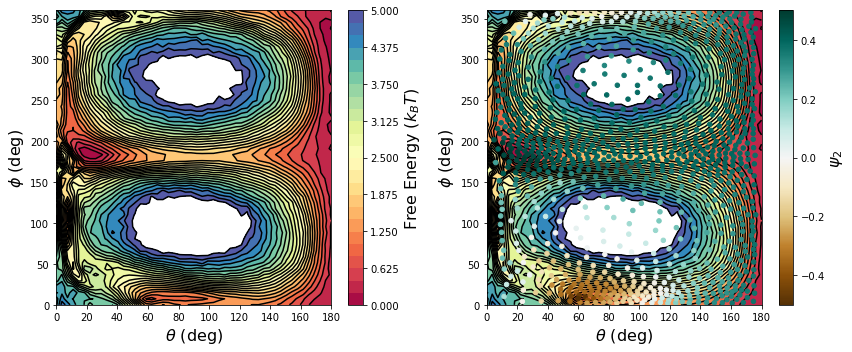

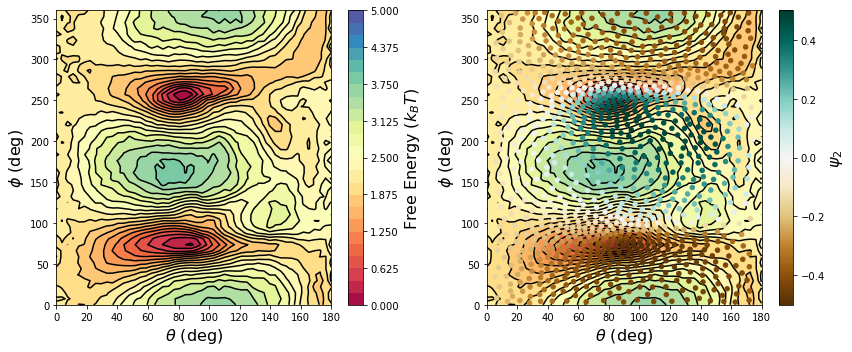

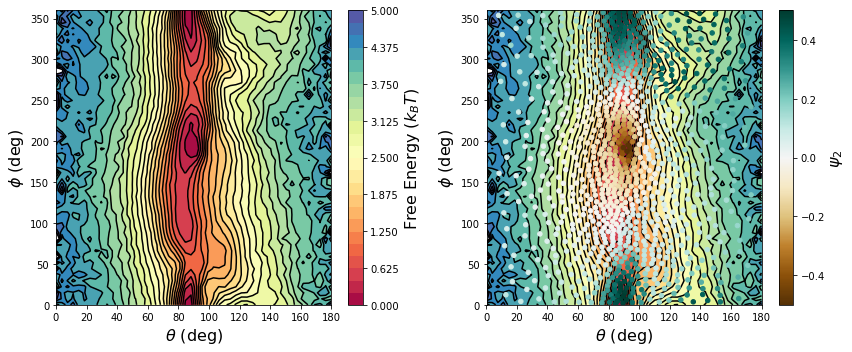

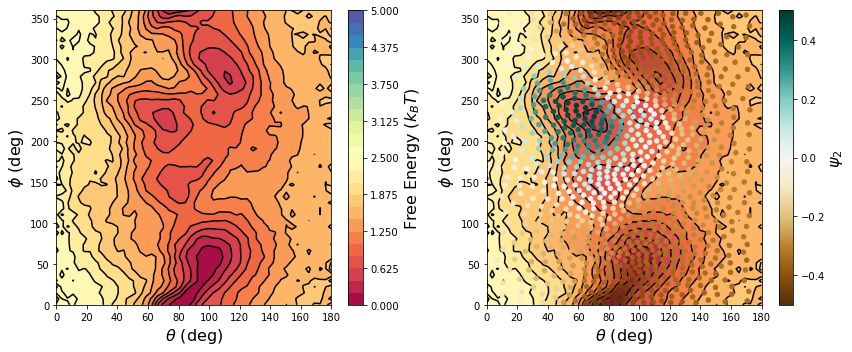

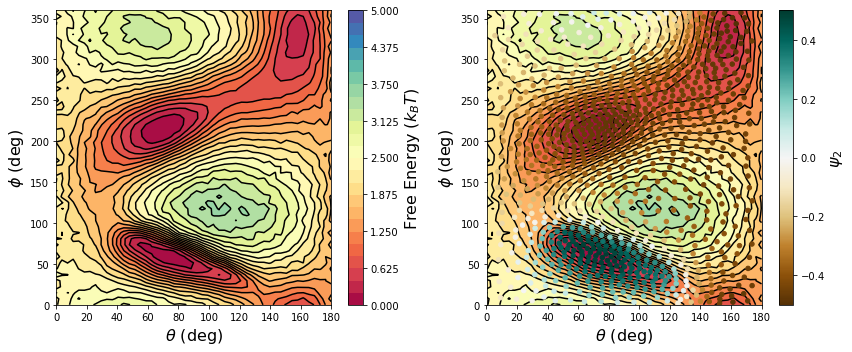

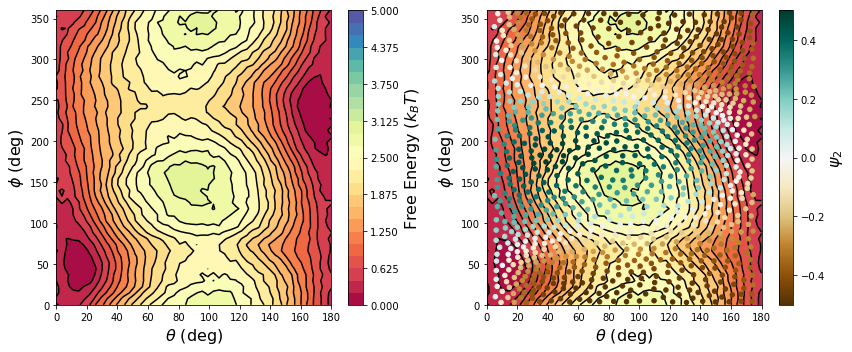

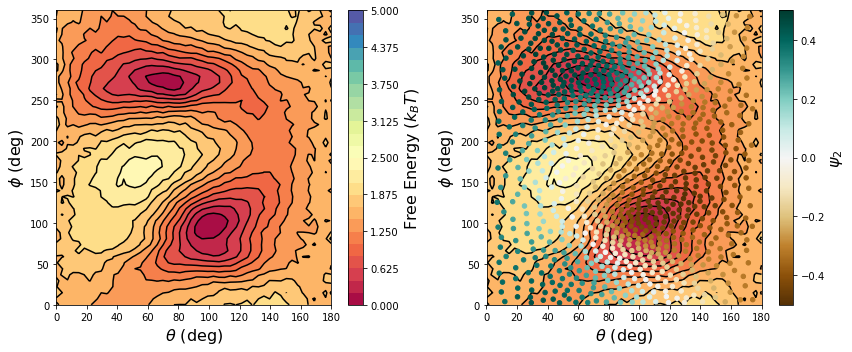

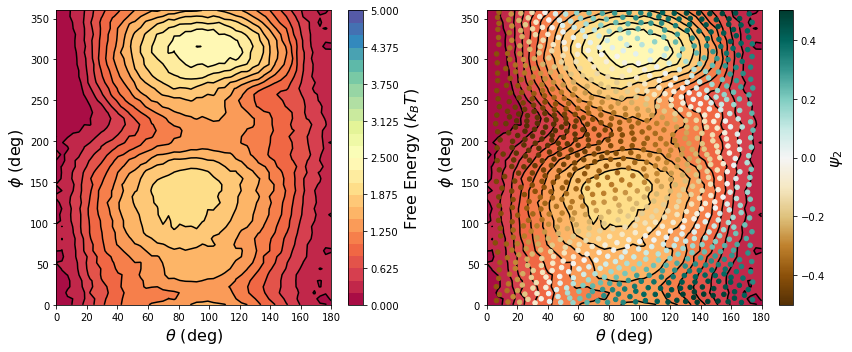

In [17]:
#Plot \psi_2

import pyemma
from mpl_toolkits.axes_grid1 import make_axes_locatable
import scipy.interpolate

def removearray(L,arr):
    ind = 0
    size = len(L)
    while ind != size and not np.array_equal(L[ind],arr):
        #Find the index in the list of the array of interest
        ind += 1
    #Make sure that the array is actually in the list
    if ind != size:
        #If the array is in the list, get rid of it
        #Could probably also use del L[ind] here
        L.pop(ind)
    else:
        raise ValueError('array not found in list.')

fes_min = 0
fes_max = 5
lags = [14000, 7500, 10000, 1500, 24500, 10000, 15000, 50, 2500, 1000]
counter = 0
k = 1000
for mode in range(1, 11):
    data = np.load('../anly_'+str(mode)+'.npy')[:,0:2]
    dummy0 = data[:,0]
    dummy1 = data[:,1]
    ext1=[data[:,0].min(),data[:,0].max(),data[:,1].min(),data[:,1].max()]
    histo,xbins,ybins = np.histogram2d(data[:,0],data[:,1],bins = 50)
    histo = histo/histo.sum()
    fes1 = -np.ma.log(histo.T)
    fes1 = fes1 - fes1.min()
    
    fes1 = np.load('../fes'+str(mode)+'.npy')
    
    lag = lags[counter]

    dtrajs = np.load('../1000microstates/mode'+str(mode)+'/dtrajs_kmeans.npy').ravel()
    cc = np.load('../1000microstates/mode'+str(mode)+'/dtrajs_clustercenters.npy')
    cc_x = cc[:,0]
    cc_y = cc[:,1]

    M = pyemma.msm.estimate_markov_model(dtrajs,lag = lags[counter])

    r2 = M.eigenvectors_right()[:,1]
    r2 = (r2 - r2.min()) / (r2.max() - r2.min()) - 0.5

    fes = fes1
    ext = [dummy0.min(), dummy0.max(), dummy1.min(), dummy1.max()]
    nbins = 100
    fig, (ax,ax1) = plt.subplots(1, 2, figsize=(12, 5))    
    ax1.contourf(fes,zorder=-13,levels=np.linspace(fes_min,fes_max,nbins//4),cmap='Spectral',extent=ext)
    ax1.contour(fes,zorder=-12,levels=np.linspace(fes_min,fes_max,nbins//4),colors='k',extent=ext)
    ax1.set_xlabel(r'$\theta$ (deg)', fontsize = 16)
    ax1.set_ylabel(r'$\phi$ (deg)', fontsize = 16)
    im1=ax1.scatter(cc_x,cc_y,c=r2,cmap='BrBG',s=20)
    cbar=fig.colorbar(im1,ax=ax1)
    cbar.set_label(r"$\psi_{2}$", size = 16)
    ax1.set_xlim((ext[0],ext[1]))
    ax1.set_ylim((ext[2],ext[3]))   

    im2=ax.contourf(fes,zorder=-13,levels=np.linspace(fes_min,fes_max,nbins//4),cmap='Spectral',extent=ext)
    ax.contour(fes,zorder=-12,levels=np.linspace(fes_min,fes_max,nbins//4),colors='k',extent=ext)
    cbar=fig.colorbar(im2,ax=ax)
    cbar.set_label(r'Free Energy $(k_BT)$', size = 16)
    #ax1.set_xlim((ext[0],ext[1]))
    #ax1.set_ylim((ext[2],ext[3]))
    ax.set_xlabel(r'$\theta$ (deg)', fontsize = 16)
    ax.set_ylabel(r'$\phi$ (deg)', fontsize = 16)

    plt.tight_layout()
    plt.savefig('../figures/r2_scatter_mode'+str(mode)+'.pdf', dpi = 300)
    plt.show()
    plt.close()
    
    counter += 1

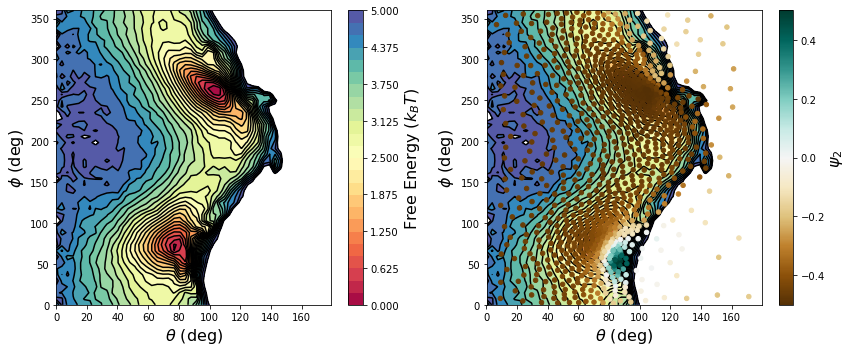

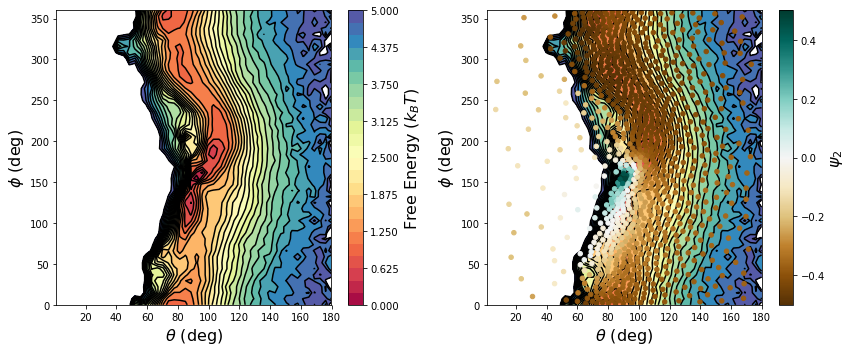

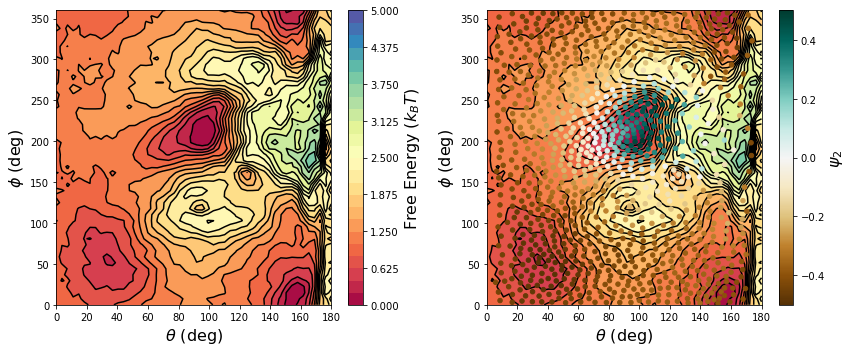

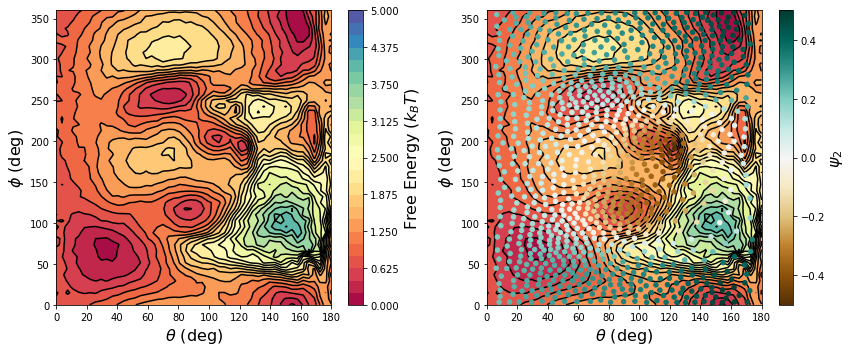

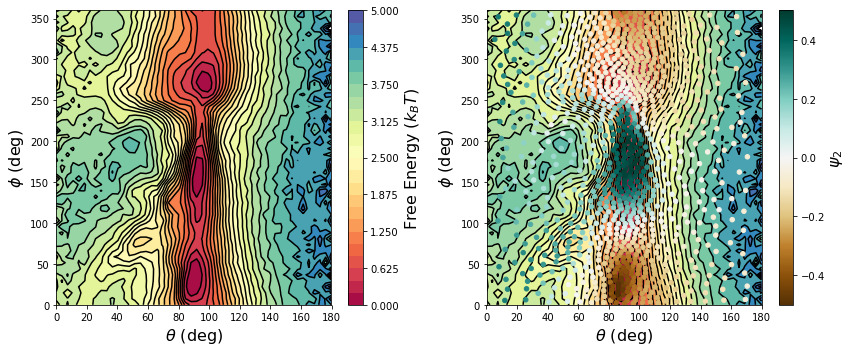

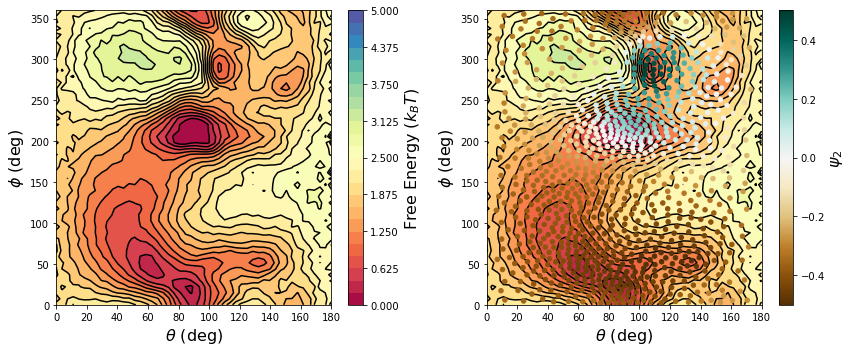

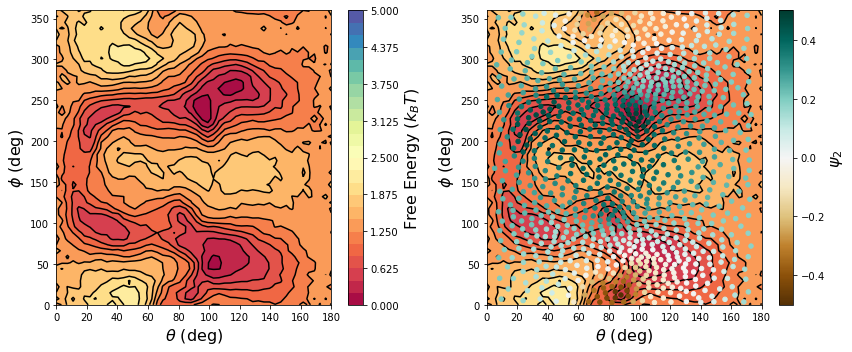

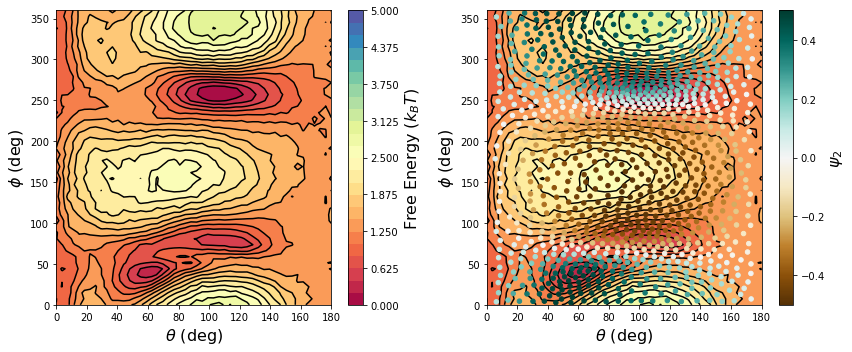

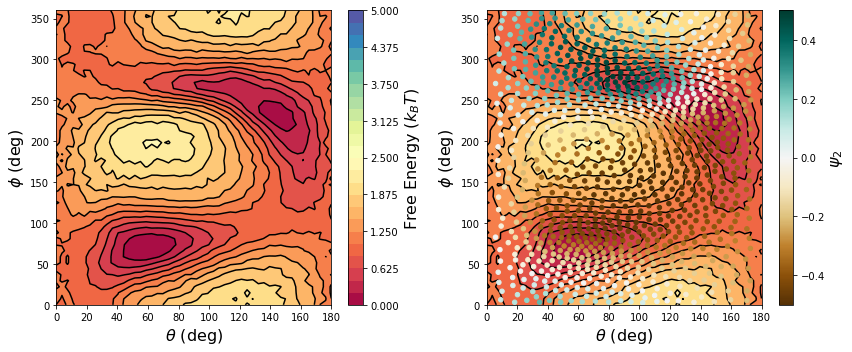

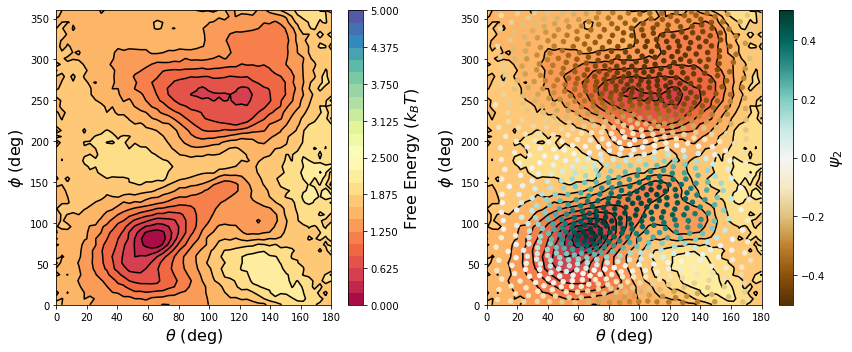

In [18]:
#Plot \psi_2

import pyemma
from mpl_toolkits.axes_grid1 import make_axes_locatable
import scipy.interpolate

def removearray(L,arr):
    ind = 0
    size = len(L)
    while ind != size and not np.array_equal(L[ind],arr):
        #Find the index in the list of the array of interest
        ind += 1
    #Make sure that the array is actually in the list
    if ind != size:
        #If the array is in the list, get rid of it
        #Could probably also use del L[ind] here
        L.pop(ind)
    else:
        raise ValueError('array not found in list.')

lag = [16000, 5500, 12500, 20000, 20000, 5000, 10000, 1000, 500, 500]
counter = 0
for mode in range(1, 11):
    data = np.load('../anly_HA_'+str(mode)+'.npy')[:,0:2]
    dummy0 = data[:,0]
    dummy1 = data[:,1]
    ext1=[data[:,0].min(),data[:,0].max(),data[:,1].min(),data[:,1].max()]
    histo,xbins,ybins = np.histogram2d(data[:,0],data[:,1],bins = 50)
    histo = histo/histo.sum()
    fes1 = -np.ma.log(histo.T)
    fes1 = fes1 - fes1.min()
    
    fes1 = np.load('../HA_fes'+str(mode)+'.npy')

    lag = lags[counter]
    dtrajs = np.load('../1000microstates/HA_mode'+str(mode)+'/dtrajs_kmeans.npy').ravel()
    cc = np.load('../1000microstates/HA_mode'+str(mode)+'/dtrajs_clustercenters.npy')
    cc_x = cc[:,0]
    cc_y = cc[:,1]

    M = pyemma.msm.estimate_markov_model(dtrajs,lag = lags[counter])

    r2 = M.eigenvectors_right()[:,1]
    r2 = (r2 - r2.min()) / (r2.max() - r2.min()) - 0.5

    fes = fes1
    ext = [dummy0.min(), dummy0.max(), dummy1.min(), dummy1.max()]
    nbins = 100
    fig, (ax,ax1) = plt.subplots(1, 2, figsize=(12, 5))    
    ax1.contourf(fes,zorder=-13,levels=np.linspace(fes_min,fes_max,nbins//4),cmap='Spectral',extent=ext)
    ax1.contour(fes,zorder=-12,levels=np.linspace(fes_min,fes_max,nbins//4),colors='k',extent=ext)
    ax1.set_xlabel(r'$\theta$ (deg)', fontsize = 16)
    ax1.set_ylabel(r'$\phi$ (deg)', fontsize = 16)
    im1=ax1.scatter(cc_x,cc_y,c=r2,cmap='BrBG',s=20)
    cbar=fig.colorbar(im1,ax=ax1)
    cbar.set_label(r"$\psi_{2}$", size = 16)
    ax1.set_xlim((ext[0],ext[1]))
    ax1.set_ylim((ext[2],ext[3]))   

    im2=ax.contourf(fes,zorder=-13,levels=np.linspace(fes_min,fes_max,nbins//4),cmap='Spectral',extent=ext)
    ax.contour(fes,zorder=-12,levels=np.linspace(fes_min,fes_max,nbins//4),colors='k',extent=ext)
    cbar=fig.colorbar(im2,ax=ax)
    cbar.set_label(r'Free Energy $(k_BT)$', size = 16)
    #ax1.set_xlim((ext[0],ext[1]))
    #ax1.set_ylim((ext[2],ext[3]))
    ax.set_xlabel(r'$\theta$ (deg)', fontsize = 16)
    ax.set_ylabel(r'$\phi$ (deg)', fontsize = 16)

    plt.tight_layout()
    plt.savefig('../figures/r2_scatter_HA_mode'+str(mode)+'.pdf', dpi = 300)
    plt.show()
    plt.close()
    
    counter += 1

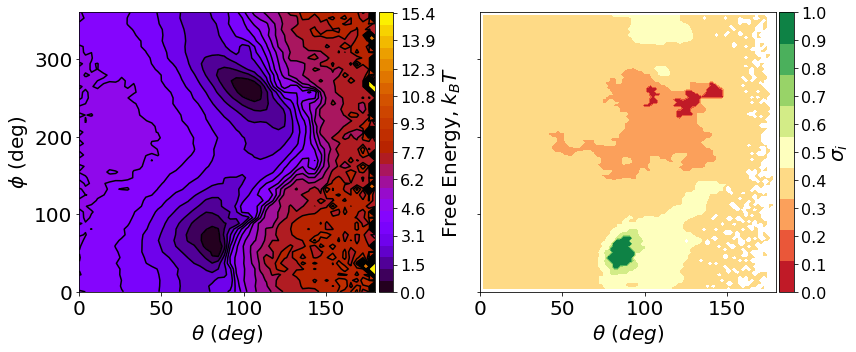

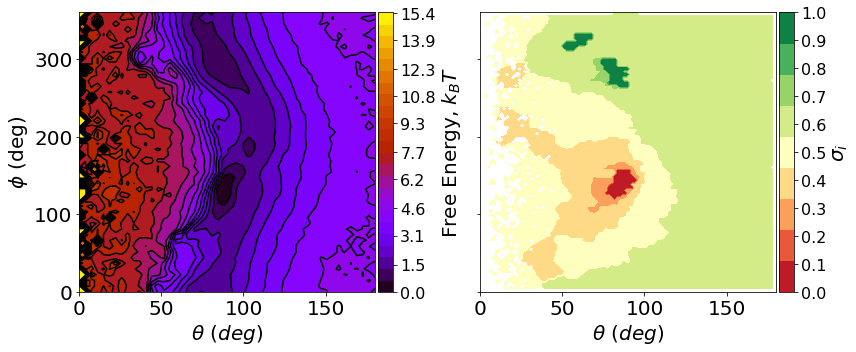

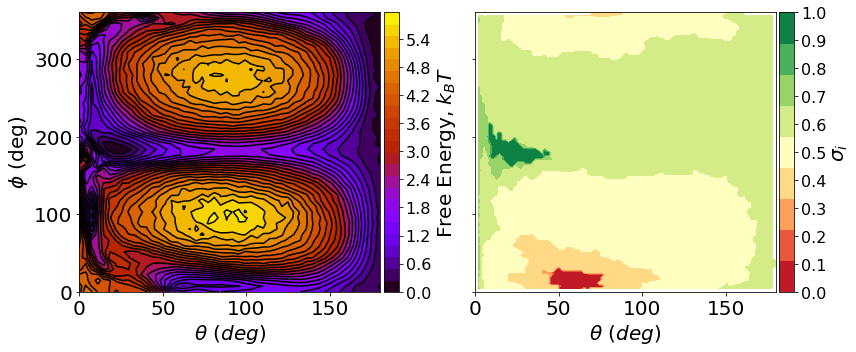

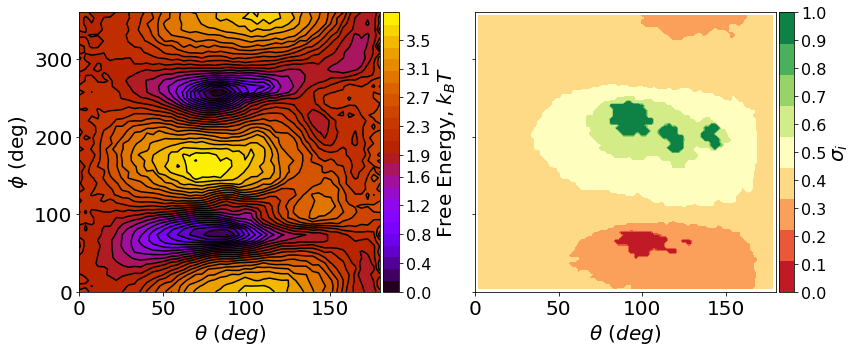

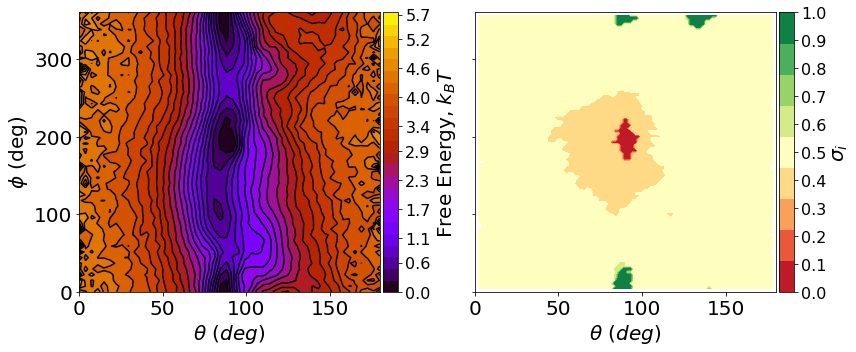

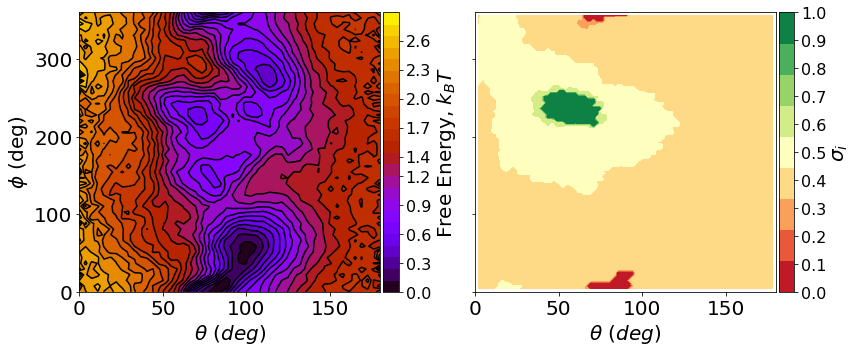

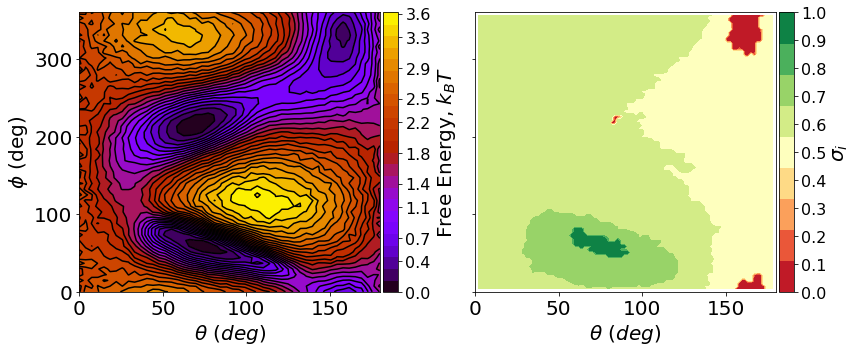

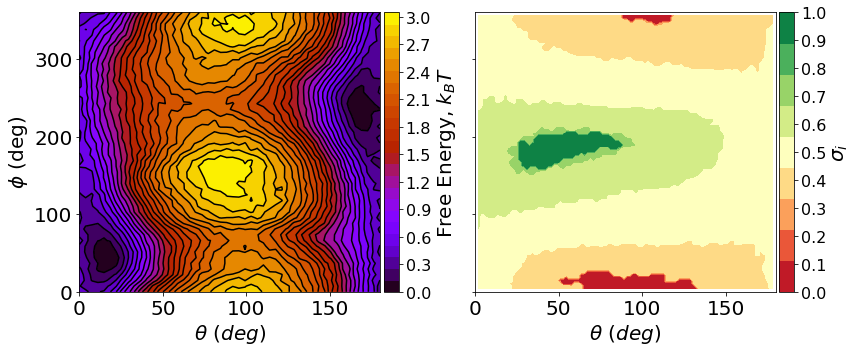

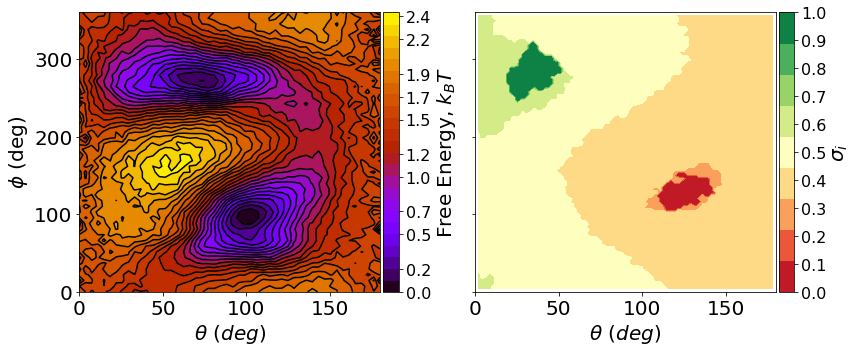

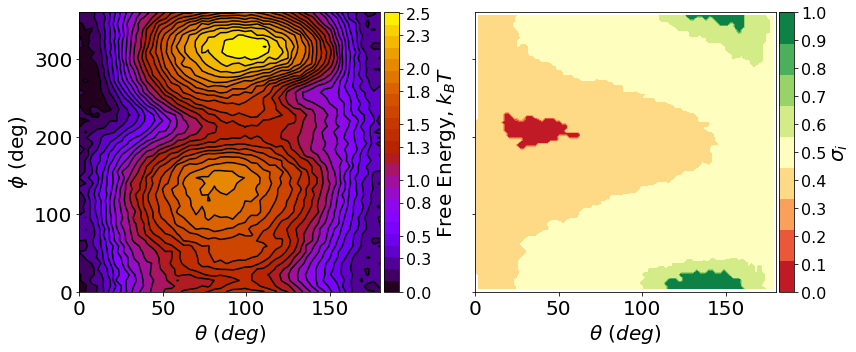

In [32]:
#Plot committor functions -- TPT

import pyemma
from mpl_toolkits.axes_grid1 import make_axes_locatable
import scipy.interpolate

def removearray(L,arr):
    ind = 0
    size = len(L)
    while ind != size and not np.array_equal(L[ind],arr):
        #Find the index in the list of the array of interest
        ind += 1
    #Make sure that the array is actually in the list
    if ind != size:
        #If the array is in the list, get rid of it
        #Could probably also use del L[ind] here
        L.pop(ind)
    else:
        raise ValueError('array not found in list.')

lag = [14000, 7500, 10000, 1500, 24500, 10000, 15000, 50, 2500, 1000]
counter = 0
for mode in range(1, 11):
    data = np.load('../anly_'+str(mode)+'.npy')[:,0:2]
    ext1=[data[:,0].min(),data[:,0].max(),data[:,1].min(),data[:,1].max()]
    histo,xbins,ybins = np.histogram2d(data[:,0],data[:,1],bins = 50)
    histo = histo/histo.sum()
    fes1 = -np.ma.log(histo.T)
    fes1 = fes1 - fes1.min()
    
    fes1 = np.load('../fes'+str(mode)+'.npy')

    dtrajs = np.load('../1000microstates/mode'+str(mode)+'/dtrajs_kmeans.npy').ravel()
    cc = np.load('../1000microstates/mode'+str(mode)+'/dtrajs_clustercenters.npy')
    cc_x = cc[:,0]
    cc_y = cc[:,1]

    M = pyemma.msm.estimate_markov_model(dtrajs,lag = lag[counter])

    r2 = M.eigenvectors_right()[:,1]
    r2_traj=r2[dtrajs]

    eigveclist=[]
    for j in range(len(r2)):
        if r2[j] <= 0.0:
            eigveclist.append(0)
        else:
            eigveclist.append(1)

    r2list=list(np.copy(r2))
    lowlist=[]
    highlist=[]
    for j in range(25):
        lowlist.append(np.min(r2list))
        highlist.append(np.max(r2list))
        removearray(r2list,np.array(r2list).min())
        removearray(r2list,np.array(r2list).max())
    llist=[]
    hlist=[]
    for j in range(25):
        llist.append(np.argwhere(r2==lowlist[j])[0][0])
        hlist.append(np.argwhere(r2==highlist[j])[0][0])
        
    tpt_obj=pyemma.msm.tpt(M,llist,hlist)
    sigma = tpt_obj.committor
    nbins=100
    xall=data[:,0]
    yall=data[:,1]
    sigma_traj = sigma[dtrajs]
    x,y=np.meshgrid(np.linspace(xall.min(),xall.max(),nbins),
                    np.linspace(yall.min(),yall.max(),nbins))
    z = scipy.interpolate.griddata(np.column_stack([xall,yall]),sigma_traj,(x,y),method='linear')

    #Implement a mask to remove unsampled regions from the contour plot
    counts, xedge, yedge = np.histogram2d(
        xall, yall, bins=nbins, weights=None)
    counts = counts.T
    z=np.ma.masked_where(counts <= 0, z)
    #Make the plot: macrostate decomposition with solid borders

    ext=[xall.min(),xall.max(),yall.min(),yall.max()]

    #Set the min and max values of the contour plot
    vmin = np.min(sigma_traj[sigma_traj > -np.inf])
    vmax = np.max(sigma_traj[sigma_traj < np.inf])
    
    fig, (ax0,ax1) = plt.subplots(1, 2,figsize=(12,5),sharex=True,sharey=True)
    nbins = 100
    ext1 = ext
    im1=ax0.contourf(fes1,zorder=-13,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),cmap='Spectral',extent=ext1)
    ax0.contour(fes1,zorder=-12,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),colors='k',extent=ext1)
    ax0.set_xlabel(r'$\theta\ (deg)$',fontsize=20)
    ax0.set_ylabel(r'$\phi$ (deg)',fontsize=20)

    ax0.set_xlim((ext[0],ext[1]))
    ax0.set_ylim((ext[2],ext[3]))
    divider = make_axes_locatable(ax0)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im1, cax=cax,ticks=list(np.around(np.linspace(fes1.min(),fes1.max(),11),decimals=1)))
    cbar.set_label(r"Free Energy, $k_BT$",fontsize=20)
    cbar.ax.tick_params(labelsize=16)
    ax0.tick_params(labelsize=20)

    #ax1.contourf(fes1,zorder=-13,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),cmap='gnuplot',extent=ext1)
    #ax1.contour(fes1,zorder=-12,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),colors='k',extent=ext1)
    im1=ax1.contourf(x, y, z,levels=np.linspace(sigma.min(),sigma.max(),10),vmin=vmin,vmax=vmax,alpha=1.0,cmap='RdYlGn',extent=ext1)
    ax1.set_xlabel(r'$\theta\ (deg)$',fontsize=20)
    #ax1.set_ylabel(r'$\phi$ (deg)',fontsize=20)
    #im1=ax1.scatter(cc_x,cc_y,c=sigma,cmap='RdYlGn',s=25)
    #ax1.scatter(cc_x[llist],cc_y[llist],c='c',s=25,marker='*')
    #ax1.scatter(cc_x[hlist],cc_y[hlist],c='y',s=25,marker='*')
    ax1.set_xlim((ext[0],ext[1]))
    ax1.set_ylim((ext[2],ext[3]))
    divider = make_axes_locatable(ax1)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im1, cax=cax,ticks=[0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
    cbar.set_label(r"$\sigma_{i}$",fontsize=20)
    cbar.ax.tick_params(labelsize=16)
    ax1.tick_params(labelsize=20)

    #fig.suptitle('Mode '+str(mode))
    plt.tight_layout()
    plt.savefig('../figures/committor_mode'+str(mode)+'_TPT_core_new.pdf',dpi=1000)
    plt.show()
    plt.close()
    
    counter += 1

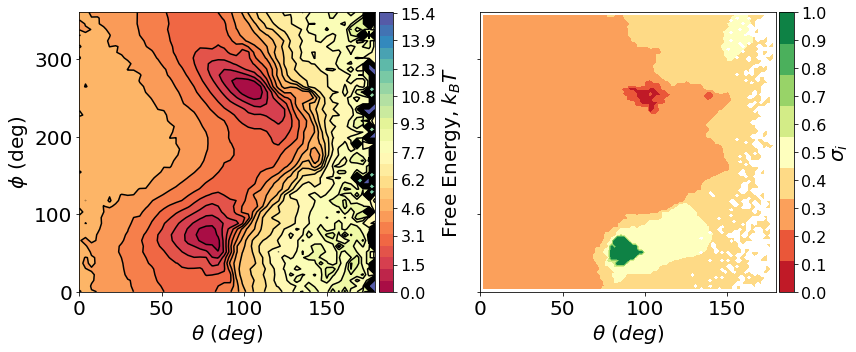

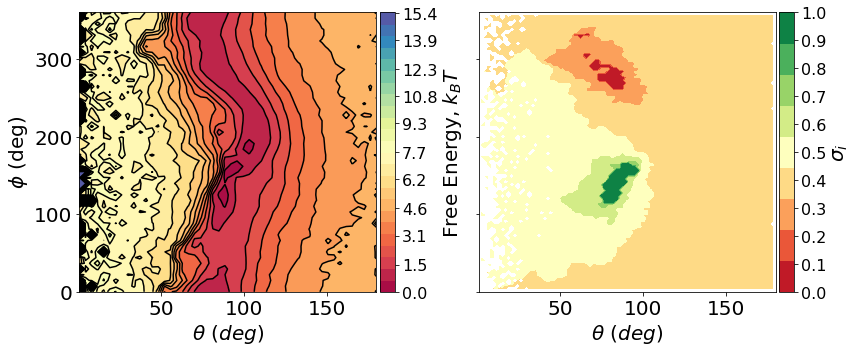

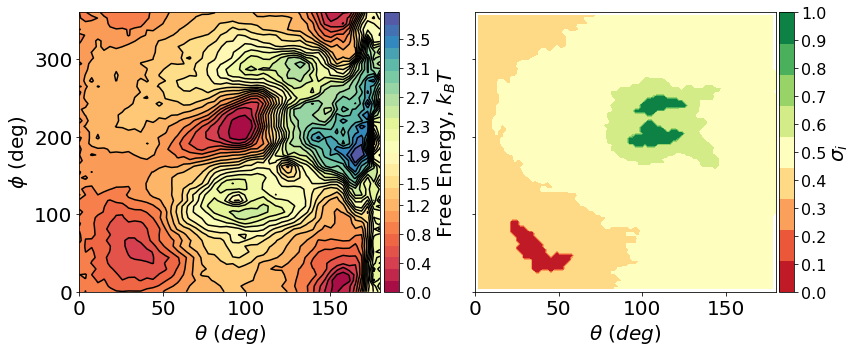

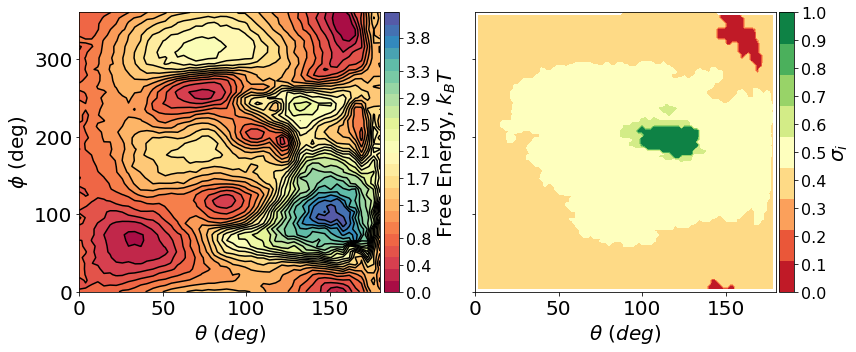

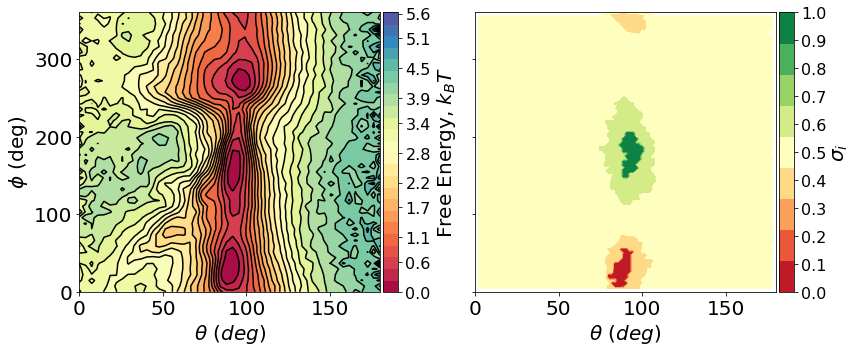

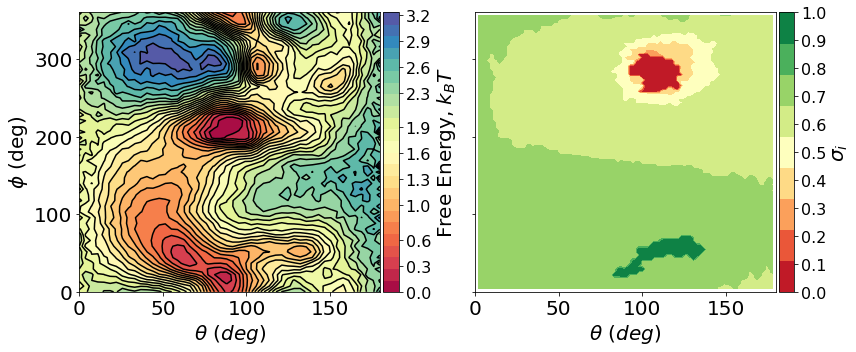

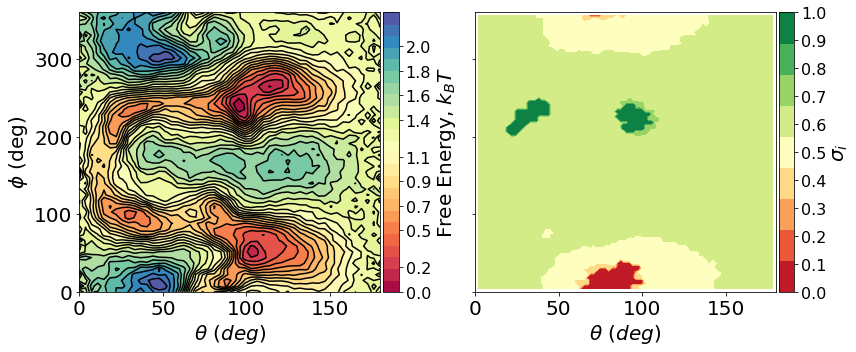

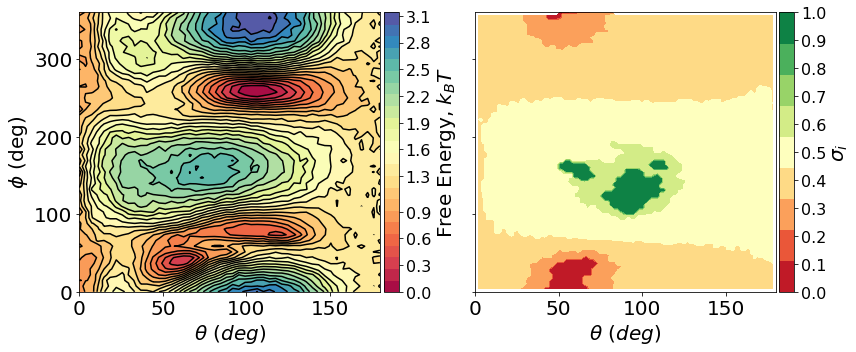

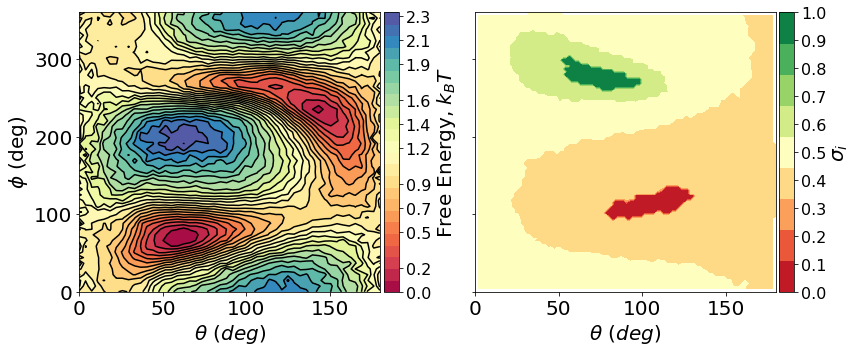

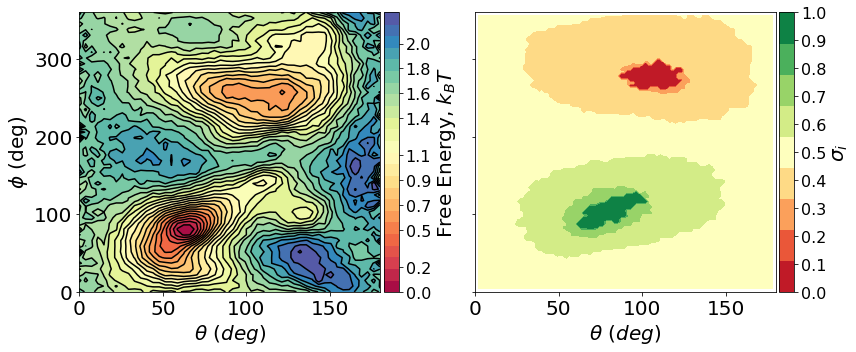

In [34]:
#Plot committor functions -- TPT

import pyemma
from mpl_toolkits.axes_grid1 import make_axes_locatable
import scipy.interpolate

def removearray(L,arr):
    ind = 0
    size = len(L)
    while ind != size and not np.array_equal(L[ind],arr):
        #Find the index in the list of the array of interest
        ind += 1
    #Make sure that the array is actually in the list
    if ind != size:
        #If the array is in the list, get rid of it
        #Could probably also use del L[ind] here
        L.pop(ind)
    else:
        raise ValueError('array not found in list.')

lag = [16000, 5500, 12500, 20000, 20000, 5000, 10000, 1000, 500, 500]
counter = 0
for mode in range(1, 11):
    data = np.load('../anly_HA_'+str(mode)+'.npy')[:,0:2]
    ext1=[data[:,0].min(),data[:,0].max(),data[:,1].min(),data[:,1].max()]
    histo,xbins,ybins = np.histogram2d(data[:,0],data[:,1],bins = 50)
    histo = histo/histo.sum()
    fes1 = -np.ma.log(histo.T)
    fes1 = fes1 - fes1.min()
    
    fes1 = np.load('../HA_fes'+str(mode)+'.npy')

    dtrajs = np.load('../1000microstates/HA_mode'+str(mode)+'/dtrajs_kmeans.npy').ravel()
    cc = np.load('../1000microstates/HA_mode'+str(mode)+'/dtrajs_clustercenters.npy')
    cc_x = cc[:,0]
    cc_y = cc[:,1]

    M = pyemma.msm.estimate_markov_model(dtrajs,lag = lag[counter])

    r2 = M.eigenvectors_right()[:,1]
    r2_traj=r2[dtrajs]

    eigveclist=[]
    for j in range(len(r2)):
        if r2[j] <= 0.0:
            eigveclist.append(0)
        else:
            eigveclist.append(1)

    r2list=list(np.copy(r2))
    lowlist=[]
    highlist=[]
    for j in range(25):
        lowlist.append(np.min(r2list))
        highlist.append(np.max(r2list))
        removearray(r2list,np.array(r2list).min())
        removearray(r2list,np.array(r2list).max())
    llist=[]
    hlist=[]
    for j in range(25):
        llist.append(np.argwhere(r2==lowlist[j])[0][0])
        hlist.append(np.argwhere(r2==highlist[j])[0][0])
        
    tpt_obj=pyemma.msm.tpt(M,llist,hlist)
    sigma = tpt_obj.committor
    nbins=100
    xall=data[:,0]
    yall=data[:,1]
    sigma_traj = sigma[dtrajs]
    x,y=np.meshgrid(np.linspace(xall.min(),xall.max(),nbins),
                    np.linspace(yall.min(),yall.max(),nbins))
    z = scipy.interpolate.griddata(np.column_stack([xall,yall]),sigma_traj,(x,y),method='linear')

    #Implement a mask to remove unsampled regions from the contour plot
    counts, xedge, yedge = np.histogram2d(
        xall, yall, bins=nbins, weights=None)
    counts = counts.T
    z=np.ma.masked_where(counts <= 0, z)
    #Make the plot: macrostate decomposition with solid borders

    ext=[xall.min(),xall.max(),yall.min(),yall.max()]

    #Set the min and max values of the contour plot
    vmin = np.min(sigma_traj[sigma_traj > -np.inf])
    vmax = np.max(sigma_traj[sigma_traj < np.inf])
    
    fig, (ax0,ax1) = plt.subplots(1, 2,figsize=(12,5),sharex=True,sharey=True)
    nbins = 100
    ext1 = ext
    im1=ax0.contourf(fes1,zorder=-13,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),cmap='Spectral',extent=ext1)
    ax0.contour(fes1,zorder=-12,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),colors='k',extent=ext1)
    ax0.set_xlabel(r'$\theta\ (deg)$',fontsize=20)
    ax0.set_ylabel(r'$\phi$ (deg)',fontsize=20)

    ax0.set_xlim((ext[0],ext[1]))
    ax0.set_ylim((ext[2],ext[3]))
    divider = make_axes_locatable(ax0)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im1, cax=cax,ticks=list(np.around(np.linspace(fes1.min(),fes1.max(),11),decimals=1)))
    cbar.set_label(r"Free Energy, $k_BT$",fontsize=20)
    cbar.ax.tick_params(labelsize=16)
    ax0.tick_params(labelsize=20)

    #ax1.contourf(fes1,zorder=-13,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),cmap='gnuplot',extent=ext1)
    #ax1.contour(fes1,zorder=-12,levels=np.linspace(fes1.min(),fes1.max(),nbins//4),colors='k',extent=ext1)
    im1=ax1.contourf(x, y, z,levels=np.linspace(sigma.min(),sigma.max(),10),vmin=vmin,vmax=vmax,alpha=1.0,cmap='RdYlGn',extent=ext1)
    ax1.set_xlabel(r'$\theta\ (deg)$',fontsize=20)
    #ax1.set_ylabel(r'$\phi$ (deg)',fontsize=20)
    #im1=ax1.scatter(cc_x,cc_y,c=sigma,cmap='RdYlGn',s=25)
    #ax1.scatter(cc_x[llist],cc_y[llist],c='c',s=25,marker='*')
    #ax1.scatter(cc_x[hlist],cc_y[hlist],c='y',s=25,marker='*')
    ax1.set_xlim((ext[0],ext[1]))
    ax1.set_ylim((ext[2],ext[3]))
    divider = make_axes_locatable(ax1)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im1, cax=cax,ticks=[0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
    cbar.set_label(r"$\sigma_{i}$",fontsize=20)
    cbar.ax.tick_params(labelsize=16)
    ax1.tick_params(labelsize=20)

    #fig.suptitle('Mode '+str(mode))
    plt.tight_layout()
    plt.savefig('../figures/committor_HA_mode'+str(mode)+'_TPT_core_new.pdf',dpi=1000)
    plt.show()
    plt.close()
    
    counter += 1

In [37]:
#Local Mode Lengthscale -- observe the effects of HI

PATH = '../'
PATH_LE4PD = '../../lml/'

N = 76

Q = np.reshape(np.loadtxt('../com_HCmatrix'), (3*N, 3*N))
eigvals = np.loadtxt('../com_covar_eig')

lml = np.zeros((N, 3*N))
lml_HA = np.zeros((N, 3*N))
lml_le4pd = np.zeros((N, 3*N))

for a in range(3*N):
    num = 0
    for i in range(0, 3*N, 3):
        lml_HA[num, a] = (Q[i, a]**2 + Q[i+1, a]**2 + Q[i+2, a]**2)*eigvals[a]*100
        num += 1
lml_HA = np.sqrt(lml_HA)
        
for i in range(1, 3*N + 1):
    lml[:,i - 1] = np.loadtxt(PATH + 'lml_' + str(i) + '.dat')
    #lml_HA[:, i - 1] = np.loadtxt(PATH + 'HC_lml_' + str(i) + '.dat')
    #dummy = np.loadtxt(PATH_LE4PD + 'lml_' + str(i + 3) + '.dat')
    #lml_le4pd[1:, i - 1] = np.loadtxt(PATH_LE4PD + 'lml_' + str(i + 3) + '.dat')
    #lml[0, i - 1] = dummy[0]

In [7]:
eigvals.sum()

1.6136895923107293

In [29]:
(lml**2).sum()

161.36895923107278

In [38]:
(lml_HA**2).sum()

161.36895923107292

In [23]:
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (3*N, 3*N))

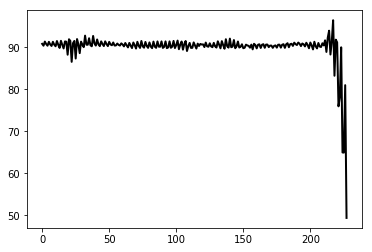

In [59]:
plt.plot(np.rad2deg(np.arccos((Q[:,2]))), lw = 2, c = 'k')
plt.show()
plt.close()

In [33]:
(Q[:,0]**2).sum()

1.0

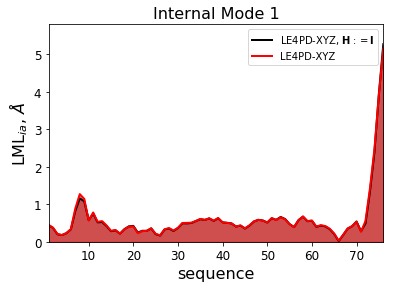

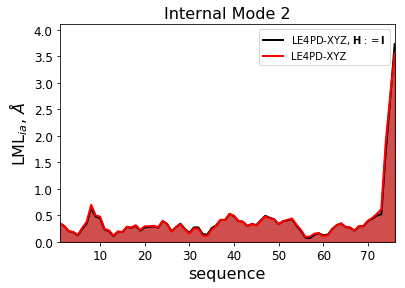

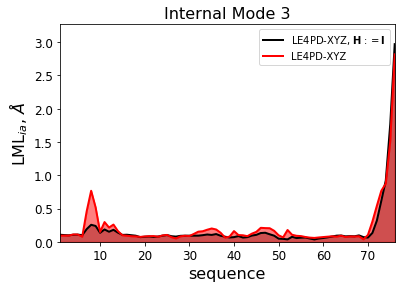

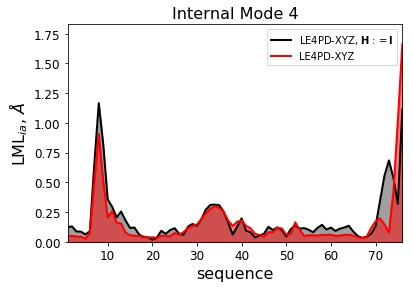

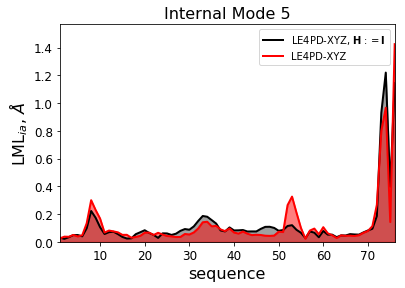

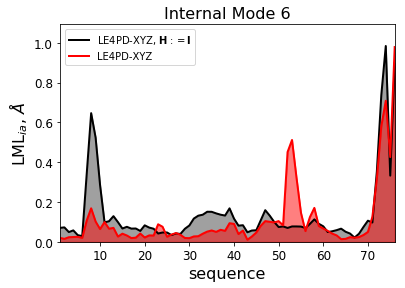

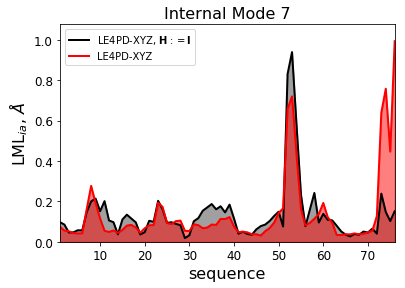

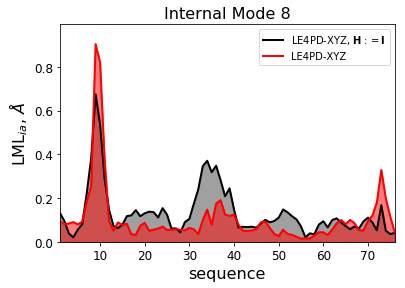

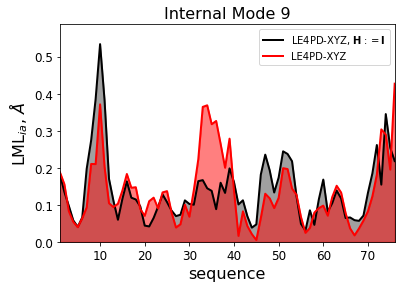

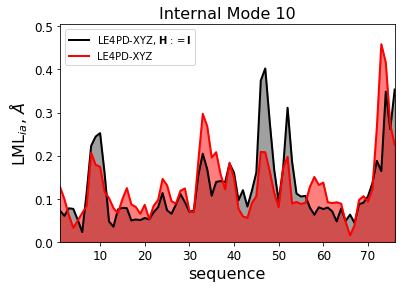

In [46]:
for a in range(10):
    plt.plot(np.arange(1, 77),lml[:,a], lw = 2, c = 'k', label = r'LE4PD-XYZ, $\mathbf{H}:=\mathbf{I}$')
    plt.fill_between(np.arange(1, 77), 0, lml[:,a], color = 'grey', alpha = 0.75)
    plt.plot(np.arange(1, 77),lml_HA[:,order[a]], lw = 2, c = 'r', label = 'LE4PD-XYZ')
    plt.fill_between(np.arange(1, 77), 0, lml_HA[:,order[a]], color = 'r', alpha = 0.5)
    #plt.plot(np.arange(1, 77),lml_le4pd[:,a], lw = 2, c = 'b', label = 'LE4PD')
    #plt.fill_between(np.arange(1, 77), 0, lml_le4pd[:,a], color = 'b', alpha = 0.25)
    plt.xlabel('sequence', fontsize = 16)
    plt.ylabel(r'LML$_{ia}$, $\AA$', fontsize = 16)
    plt.xticks(size = 12)
    plt.yticks(size = 12)
    plt.xlim((1, 76))
    plt.ylim((0, 1.1*np.max(np.array([lml[:,a].max(), lml_HA[:,a].max()]))))
    plt.title('Internal Mode '+str(a + 1), fontsize = 16)
    plt.legend()
    #plt.savefig('../figures/no_iso_lml_comp_mode' + str(a + 1) + '.pdf', dpi = 300)
    plt.show()
    plt.close()

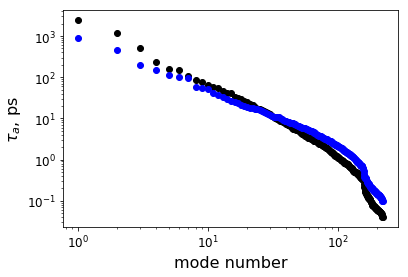

In [6]:
#Compare unscaled timescales with and without HI

tau = np.loadtxt('../tau_3N.dat')
tau_HA = np.loadtxt('../tau_3N_HA.dat')

plt.plot(tau[:-6, 0], tau[:-6, 1], marker = 'o', lw = 0, c = 'k')
plt.plot(tau_HA[:-6, 0], tau_HA[:-6, 1], marker = 'o', lw = 0, c = 'b')
plt.xlabel('mode number', fontsize = 16)
plt.ylabel(r'$\tau_a$, ps', fontsize = 16)
plt.xticks(size = 12)
plt.yticks(size = 12)
plt.xscale('log')
plt.yscale('log')
plt.savefig('../figures/tau_comp.pdf', dpi = 300)
plt.show()
plt.close()

In [8]:
H = np.reshape(np.loadtxt('../../Hmatrix'), (76, 76))

In [6]:
(H > 0).sum()

5776

In [21]:
eigvals, eigvecs = np.linalg.eigh(H)

In [24]:
np.linalg.eig(H)

(array([14.6962032 ,  4.61152641,  4.0165226 ,  3.70968754,  3.14013222,
         2.62264745,  2.38032565,  2.32489402,  2.00470286,  1.9017297 ,
         1.79195664,  1.72208271,  1.6144823 ,  1.53344595,  1.41842569,
         1.30130343,  1.24340461,  1.21836849,  1.14042638,  1.09823874,
         1.02714355,  0.99448975,  0.96491135,  0.92008658,  0.85366828,
         0.80577579,  0.79243277,  0.74993589,  0.74294143,  0.71515672,
         0.69183074,  0.67719092,  0.65639888,  0.64330765,  0.06207159,
         0.5940936 ,  0.5830287 ,  0.0888848 ,  0.57790023,  0.56308242,
         0.5526125 ,  0.53575014,  0.51561233,  0.49457474,  0.48813187,
         0.12077626,  0.46682221,  0.45228607,  0.13031791,  0.14124401,
         0.43278748,  0.1612837 ,  0.39929155,  0.4275129 ,  0.41916663,
         0.17884091,  0.36543737,  0.35160398,  0.36111069,  0.33708402,
         0.19126439,  0.19404437,  0.19927181,  0.31793206,  0.21062176,
         0.28508041,  0.30190955,  0.27329491,  0.2

In [16]:
for i in range(76):
    print(eigvecs[:,i].sum())

0.0010980036258634689
-0.004827382124209556
0.016042109037102476
0.006877881951455198
-0.0030863984898165664
0.010063272346915026
-0.028602857582364586
0.02227022716350448
-0.01838589617289001
-0.004897692128413476
0.014506805675029422
0.0007449073512703205
-0.039144811406359475
0.02266290464110647
0.0036773765812524173
0.00212130359777298
-0.01158670943776266
-0.008864374557477472
0.013775059463759148
0.020490839279807223
-0.023180453693163107
-0.002041417952974651
-0.02147212776301314
-0.006373272948968826
-0.049748284290647704
0.015409221563078595
0.04088564142342618
-0.023067741179634903
-0.002616021124105805
0.04288793307171625
0.0529046902796533
0.0336564147665307
-0.02850331248217053
-0.004311824491254182
0.003648196653393415
0.021385098406320018
0.058956114840057326
0.04132089224019078
-0.011415423716557321
0.002862320379659205
-0.05361830742997116
0.06436999958185094
0.03596451869760963
0.1318240736548527
0.021964040586954017
-0.04751213165511302
0.06573136324409679
-0.0235363

In [23]:
eigvecs[:,-1]

array([-0.10145016, -0.11150211, -0.12537214, -0.12589145, -0.13385328,
       -0.1233347 , -0.11857567, -0.10401016, -0.09626162, -0.09928655,
       -0.1007404 , -0.11144573, -0.11519703, -0.11613688, -0.12027955,
       -0.11337236, -0.11637976, -0.10807742, -0.11137136, -0.10726794,
       -0.11646455, -0.12437485, -0.13346774, -0.12467623, -0.12372102,
       -0.13610616, -0.13426241, -0.12450017, -0.12298718, -0.12977087,
       -0.12003542, -0.10950274, -0.1073241 , -0.108045  , -0.10703002,
       -0.10988902, -0.10887569, -0.11847789, -0.10652837, -0.11010324,
       -0.12530425, -0.1250133 , -0.13472342, -0.12724787, -0.11969533,
       -0.10599129, -0.10641955, -0.10466063, -0.1141691 , -0.12171499,
       -0.11423966, -0.11673189, -0.10944213, -0.10980492, -0.1198228 ,
       -0.12499932, -0.11103824, -0.10452922, -0.10944677, -0.10643426,
       -0.11501471, -0.10694391, -0.10639451, -0.1070996 , -0.1160631 ,
       -0.12211314, -0.1322526 , -0.12924052, -0.13126782, -0.11

In [26]:
QHA = np.reshape(np.loadtxt('../com_HCmatrix'), (228, 228))
QINVHA = np.linalg.inv(QHA)
lamb = np.diag(np.loadtxt('../com_HC_eig'))

In [29]:
HA = np.matmul(QINVHA, np.matmul(lamb, QHA))

In [30]:
HAHAT = np.matmul(HA, HA.T)
HATHA = np.matmul(HA.T, HA)

In [38]:
H = np.kron(H, np.eye(3))

In [39]:
HA = np.matmul(H, np.linalg.pinv(covar))

In [40]:
HA

array([[ 5.82468357e+11, -1.15069420e+11, -3.81294649e+11, ...,
        -8.86115040e+11,  1.47700974e+11,  3.67675765e+11],
       [-9.97316212e+10,  8.37517403e+11, -1.26836108e+11, ...,
         1.53056001e+10, -1.18962010e+12, -8.40570377e+10],
       [-4.04317589e+11, -1.60758094e+11,  3.21207129e+11, ...,
         6.53999660e+11,  2.41321239e+11, -2.48431690e+11],
       ...,
       [-1.04526093e+12,  9.08827138e+10,  7.11166380e+11, ...,
         1.69581236e+12, -1.88485135e+11, -6.97439821e+11],
       [ 1.65176434e+11, -1.42207217e+12,  2.18569341e+11, ...,
        -1.22500844e+11,  2.12501933e+12,  1.88551653e+11],
       [ 5.05254891e+11,  3.53407596e+10, -3.62397222e+11, ...,
        -8.28158177e+11, -2.66235962e+10,  3.32832154e+11]])

In [34]:
covar = np.reshape(np.loadtxt('../com_covariance_matrix.dat'), (228, 228))

In [47]:
Q = np.reshape(np.loadtxt('../com_Rmatrix'), (228, 228))
QINV = Q.T
lamb = np.loadtxt('../com_covar_eig')

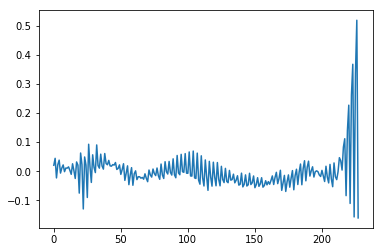

In [45]:
plt.plot(Q[:,0])

In [49]:
A = np.zeros_like(covar)
for i in range(A.shape[0]):
    if lamb[i] >= 1e-10:
        A += np.outer(Q[:,i], QINV[i,:])*lamb[i]

In [50]:
A

array([[ 1.30356133e-03, -3.32290790e-05, -6.55239663e-04, ...,
         9.21547056e-03,  2.40802656e-03, -6.06759404e-03],
       [-3.32290790e-05,  3.79913965e-03, -5.44647871e-04, ...,
         3.90969700e-03,  1.97093516e-02, -1.90563566e-03],
       [-6.55239663e-04, -5.44647871e-04,  1.75883556e-03, ...,
        -1.04561008e-02, -4.86984582e-03,  2.18562715e-03],
       ...,
       [ 9.21547056e-03,  3.90969700e-03, -1.04561008e-02, ...,
         1.85533758e-01,  6.51514892e-02, -3.76424594e-02],
       [ 2.40802656e-03,  1.97093516e-02, -4.86984582e-03, ...,
         6.51514892e-02,  2.54203153e-01, -1.89917520e-02],
       [-6.06759404e-03, -1.90563566e-03,  2.18562715e-03, ...,
        -3.76424594e-02, -1.89917520e-02,  1.06642969e-01]])

In [51]:
HA = np.matmul(H, A)

In [63]:
eigvals2, dummy = np.linalg.eig(HA)

In [56]:
A05 = linalg.fractional_matrix_power(A, 0.5)

In [64]:
eigvals3, dummy = np.linalg.eig(np.matmul(A05, np.matmul(H, A05)).real)

In [65]:
np.sort(eigvals2)

array([-2.23576304e-16, -5.49936427e-18,  1.15872368e-17,  2.95191168e-17,
        6.22305593e-17,  1.30151384e-16,  7.85617657e-07,  1.02934621e-06,
        1.55709065e-06,  1.97262827e-06,  2.12333419e-06,  2.25477117e-06,
        2.37094844e-06,  2.52844146e-06,  2.58468958e-06,  2.68500253e-06,
        2.95667439e-06,  3.08593750e-06,  3.22376049e-06,  3.31353077e-06,
        3.38677895e-06,  3.50020891e-06,  3.65553958e-06,  3.68009494e-06,
        3.92661306e-06,  4.13986718e-06,  4.24783669e-06,  4.32199231e-06,
        4.65793453e-06,  4.76633850e-06,  4.86451164e-06,  4.96821248e-06,
        5.05993735e-06,  5.18993001e-06,  5.21140522e-06,  5.48056591e-06,
        5.57427445e-06,  5.64468983e-06,  6.04678002e-06,  6.16413512e-06,
        6.18543815e-06,  6.27888750e-06,  6.60160917e-06,  6.88727023e-06,
        7.29901885e-06,  7.45308289e-06,  8.03279262e-06,  8.21180683e-06,
        8.42765965e-06,  8.55258770e-06,  8.87140331e-06,  9.17888997e-06,
        9.40212471e-06,  

In [66]:
np.sort(eigvals3)

array([-2.44619107e-16+0.00000000e+00j, -1.28109367e-17+0.00000000e+00j,
       -4.23667776e-18+0.00000000e+00j,  1.00440760e-17+0.00000000e+00j,
        8.30652129e-17-8.05588289e-18j,  8.30652129e-17+8.05588289e-18j,
        7.85617657e-07+0.00000000e+00j,  1.02934621e-06+0.00000000e+00j,
        1.55709065e-06+0.00000000e+00j,  1.97262827e-06+0.00000000e+00j,
        2.12333419e-06+0.00000000e+00j,  2.25477117e-06+0.00000000e+00j,
        2.37094844e-06+0.00000000e+00j,  2.52844146e-06+0.00000000e+00j,
        2.58468958e-06+0.00000000e+00j,  2.68500253e-06+0.00000000e+00j,
        2.95667439e-06+0.00000000e+00j,  3.08593750e-06+0.00000000e+00j,
        3.22376049e-06+0.00000000e+00j,  3.31353077e-06+0.00000000e+00j,
        3.38677895e-06+0.00000000e+00j,  3.50020891e-06+0.00000000e+00j,
        3.65553958e-06+0.00000000e+00j,  3.68009494e-06+0.00000000e+00j,
        3.92661306e-06+0.00000000e+00j,  4.13986718e-06+0.00000000e+00j,
        4.24783669e-06+0.00000000e+00j,  4.32199231